## Contexte des données

### Origine des données

Les données utilisées dans ce projet proviennent du service des ressources humaines de l'entreprise HumanForYou. Elles ont été anonymisées pour garantir la confidentialité des employés et sont fournies sous forme de fichiers CSV, chacun apportant des informations spécifiques sur les employés, leur travail, et leur satisfaction. 

Chaque employé est identifié par un identifiant unique, `EmployeeID`, qui permet de relier les différentes sources d'information.

---

### Description des fichiers

#### **1. Données du service des ressources humaines**

Ce fichier contient des informations générales sur les employés, comme leur profil, leur situation professionnelle, et leur parcours. Voici un aperçu des colonnes principales :

- **Age** : L'âge de l'employé en 2015.
- **Attrition** : Variable cible indiquant si l'employé a quitté l'entreprise en 2016 (oui/non).
- **BusinessTravel** : Fréquence des déplacements professionnels (Non-Travel, Travel_Rarely, Travel_Frequently).
- **DistanceFromHome** : Distance en kilomètres entre le domicile de l'employé et l'entreprise.
- **Education** : Niveau d'études (1 = Avant Collège, 5 = PhD).
- **EducationField** : Domaine principal d'études.
- **JobLevel** : Niveau hiérarchique (de 1 à 5).
- **JobRole** : Métier ou poste de l'employé.
- **MonthlyIncome** : Salaire brut mensuel en roupies.
- **YearsAtCompany** : Ancienneté dans l'entreprise.
- **YearsWithCurrentManager** : Années sous la responsabilité du manager actuel.
- **Department** : Département dans lequel l'employé travaille (ex. Sales, Research & Development, Human Resources). 
- **EmployeeCount** : Booléen indiquant si l'employé était compté dans les effectifs en 2015 (1 = Oui, 0 = Non).  
- **EmployeeID** : Identifiant unique de l'employé.  
- **Gender** : Sexe de l'employé (Male/Female).   
- **MaritalStatus** : Statut marital de l'employé (Single, Married, Divorced).  
- **NumCompaniesWorked** : Nombre d'entreprises pour lesquelles l'employé a travaillé avant de rejoindre HumanForYou.  
- **Over18** : Booléen indiquant si l'employé a plus de 18 ans (Oui/Non).  
- **PercentSalaryHike** : Pourcentage d'augmentation du salaire en 2015.  
- **StandardHours** : Nombre d'heures par jour dans le contrat de l'employé.  
- **StockOptionLevel** : Niveau d'investissement en actions de l'entreprise par l'employé (de 0 à 3).  
- **TotalWorkingYears** : Nombre total d'années d'expérience professionnelle de l'employé.  
- **TrainingTimesLastYear** : Nombre de jours de formation suivis par l'employé en 2015.  
- **YearsSinceLastPromotion** : Nombre d'années écoulées depuis la dernière promotion de l'employé.

**Fichier :** `general_data.csv` (550 Ko)

---

#### **2. Dernière évaluation du manager**

Ce fichier contient l'évaluation faite par les managers en février 2015, avec :

- **JobInvolvement** : Niveau d'implication dans le travail (1 = Faible, 4 = Très important).
- **PerformanceRating** : Niveau de performance annuel (1 = Faible, 4 = Au-delà des attentes).

**Fichier :** `manager_survey_data.csv` (43 Ko)

---

#### **3. Enquête qualité de vie au travail**

Ces données proviennent d'une enquête réalisée en juin 2015 par le service RH. Elle évalue trois aspects :

- **EnvironmentSatisfaction** : Satisfaction liée à l'environnement de travail (1 = Faible, 4 = Très élevé).
- **JobSatisfaction** : Satisfaction vis-à-vis du poste de travail (1 = Faible, 4 = Très élevé).
- **WorkLifeBalance** : Équilibre entre vie professionnelle et personnelle (1 = Mauvais, 4 = Excellent).

***Note:*** Certaines réponses manquent et sont notées "NA".

**Fichier :** `employee_survey_data.csv` (52 Ko)

---

#### **4. Horaires de travail**

Les horaires d'entrée et de sortie des employés sont enregistrés par des badgeuses. Ces données couvrent une période représentative de l'année 2015 (du 1er janvier au 31 décembre). Les fichiers contiennent :

- Heures d'arrivée et de départ pour chaque employé par date.

**Fichiers :** `in_out_time.zip`

---

### Résumé des données

| Fichier                       | Taille   | Description                                        |
|-------------------------------|----------|----------------------------------------------------|
| `general_data.csv`            | 550 Ko   | Informations générales sur les employés.          |
| `manager_survey_data.csv`     | 43 Ko    | Dernière évaluation par les managers.             |
| `employee_survey_data.csv`    | 52 Ko    | Enquête sur la qualité de vie au travail.         |
| `in_out_time.zip`             | Variable | Horaires d'entrée et de sortie des employés.      |

Ces données seront explorées, nettoyées, et utilisées pour construire un modèle prédictif afin d'identifier les facteurs influençant la rotation des employés. Elles offrent une vision complète des aspects personnels, professionnels, et organisationnels.


### Éthique

**Confidentialité des données** : Les données sont anonymisées, et les pratiques éthiques seront respectées tout au long du projet.

**Biais potentiels** : Il sera important de vérifier l'absence de biais dans les résultats

## 2. Chargement des Bibliothèques et des Données
---

In [4]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.metrics import confusion_matrix, classification_report, roc_curve, roc_auc_score
from sklearn.linear_model import Perceptron, LogisticRegression
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import LabelEncoder
import warnings

# Configuring display settings
plt.rcParams['figure.figsize'] = (12, 9)
sns.set()
sns.set_context('talk')
np.set_printoptions(threshold=20, precision=2, suppress=True)
pd.set_option('display.max_rows', 30)
pd.set_option('display.max_columns', None)
pd.set_option('display.precision', 2)
pd.set_option('display.float_format', '{:.2f}'.format)
warnings.filterwarnings("ignore", category=FutureWarning)

In [5]:
# Charger les datasets
employee_survey_data = pd.read_csv('employee_survey_data.csv')
general_data = pd.read_csv('general_data.csv')
in_time = pd.read_csv('in_time.csv')
manager_survey_data = pd.read_csv('manager_survey_data.csv')
out_time = pd.read_csv('out_time.csv')


**Aperçu des colonnes :**

Identifier les types de données (numériques, catégoriques).
Vérifier s'il y a des valeurs manquantes.
Examiner les noms et les formats des colonnes.
Distribution de la classe cible ("Attrition") :

Calculer le pourcentage de chaque classe.
Visualiser la répartition des classes avec un graphique.
Statistiques descriptives globales :

Examiner la tendance centrale et la dispersion (moyenne, médiane, écart-type, etc.).
Repérer d'éventuelles anomalies.

## 3. Exploration des Données (EDA - Exploratory Data Analysis)
---

 ### Traitement des Horaires d'Entrée et de Sortie

### Objectif
Cette étape consiste à traiter les données relatives aux horaires d'entrée et de sortie des employés, afin d'en extraire des informations utiles pour l'analyse de la rotation des employés. En particulier, l'objectif est de calculer des statistiques liées aux heures travaillées par chaque employé, telles que la somme des heures, le maximum, la moyenne et l'écart-type.

### Traitement des données
Les données sur les horaires d'entrée (`in_time`) et de sortie (`out_time`) contiennent des informations horaires pour chaque employé, mais nécessitent quelques étapes de transformation avant d'être analysées.

1. **Renommage des colonnes** :
   - Les colonnes contenant les identifiants des employés ont été renommées pour améliorer la lisibilité (`EmployeeID`).
   
2. **Conversion des horaires en format datetime** :
   - Les colonnes horaires ont été converties en format `datetime` pour faciliter les calculs de différences de temps.

3. **Calcul des heures travaillées** :
   - La différence entre les horaires de sortie et d'entrée a été calculée en heures. Cela a permis d'obtenir le nombre d'heures travaillées pour chaque employé, sur chaque journée de travail.

4. **Création de nouvelles statistiques** :
   - Des statistiques globales sur les heures travaillées ont été générées pour chaque employé :
     - **Somme des heures** : Total des heures travaillées sur l'ensemble de l'année.
     - **Maximum des heures** : Le plus grand nombre d'heures travaillées en une journée.
     - **Moyenne des heures** : La moyenne des heures travaillées par jour.
     - **Écart-type** : La variation des heures travaillées autour de la moyenne.
     
   Ces statistiques ont été agrégées dans un nouveau dataframe, `in_time_exe`, pour chaque employé.


Ces informations seront ensuite fusionnées avec d'autres jeux de données pour compléter l'analyse et construire un modèle prédictif.


In [6]:
in_time.rename(columns={'Unnamed: 0': 'EmployeeID'}, inplace=True)
out_time.rename(columns={'Unnamed: 0': 'EmployeeID'}, inplace=True)

for col in in_time.columns[1:]:
    in_time[col] = pd.to_datetime(in_time[col])

for col in out_time.columns[1:]:
    out_time[col] = pd.to_datetime(out_time[col])


worked_hours = (out_time.iloc[:, 1:] - in_time.iloc[:, 1:]).apply(lambda x: x.dt.total_seconds() / 3600)
worked_hours.columns = in_time.columns[1:]
worked_hours.insert(0, 'EmployeeID', in_time['EmployeeID'])

In [7]:
worked_hours.head()

,EmployeeID,2015-01-01,2015-01-02,2015-01-05,2015-01-06,2015-01-07,2015-01-08,2015-01-09,2015-01-12,2015-01-13,2015-01-14,2015-01-15,2015-01-16,2015-01-19,2015-01-20,2015-01-21,2015-01-22,2015-01-23,2015-01-26,2015-01-27,2015-01-28,2015-01-29,2015-01-30,2015-02-02,2015-02-03,2015-02-04,2015-02-05,2015-02-06,2015-02-09,2015-02-10,2015-02-11,2015-02-12,2015-02-13,2015-02-16,2015-02-17,2015-02-18,2015-02-19,2015-02-20,2015-02-23,2015-02-24,2015-02-25,2015-02-26,2015-02-27,2015-03-02,2015-03-03,2015-03-04,2015-03-05,2015-03-06,2015-03-09,2015-03-10,2015-03-11,2015-03-12,2015-03-13,2015-03-16,2015-03-17,2015-03-18,2015-03-19,2015-03-20,2015-03-23,2015-03-24,2015-03-25,2015-03-26,2015-03-27,2015-03-30,2015-03-31,2015-04-01,2015-04-02,2015-04-03,2015-04-06,2015-04-07,2015-04-08,2015-04-09,2015-04-10,2015-04-13,2015-04-14,2015-04-15,2015-04-16,2015-04-17,2015-04-20,2015-04-21,2015-04-22,2015-04-23,2015-04-24,2015-04-27,2015-04-28,2015-04-29,2015-04-30,2015-05-01,2015-05-04,2015-05-05,2015-05-06,2015-05-07,2015-05-08,2015-05-11,2015-05-12,2015-05-13,2015-05-14,2015-05-15,2015-05-18,2015-05-19,2015-05-20,2015-05-21,2015-05-22,2015-05-25,2015-05-26,2015-05-27,2015-05-28,2015-05-29,2015-06-01,2015-06-02,2015-06-03,2015-06-04,2015-06-05,2015-06-08,2015-06-09,2015-06-10,2015-06-11,2015-06-12,2015-06-15,2015-06-16,2015-06-17,2015-06-18,2015-06-19,2015-06-22,2015-06-23,2015-06-24,2015-06-25,2015-06-26,2015-06-29,2015-06-30,2015-07-01,2015-07-02,2015-07-03,2015-07-06,2015-07-07,2015-07-08,2015-07-09,2015-07-10,2015-07-13,2015-07-14,2015-07-15,2015-07-16,2015-07-17,2015-07-20,2015-07-21,2015-07-22,2015-07-23,2015-07-24,2015-07-27,2015-07-28,2015-07-29,2015-07-30,2015-07-31,2015-08-03,2015-08-04,2015-08-05,2015-08-06,2015-08-07,2015-08-10,2015-08-11,2015-08-12,2015-08-13,2015-08-14,2015-08-17,2015-08-18,2015-08-19,2015-08-20,2015-08-21,2015-08-24,2015-08-25,2015-08-26,2015-08-27,2015-08-28,2015-08-31,2015-09-01,2015-09-02,2015-09-03,2015-09-04,2015-09-07,2015-09-08,2015-09-09,2015-09-10,2015-09-11,2015-09-14,2015-09-15,2015-09-16,2015-09-17,2015-09-18,2015-09-21,2015-09-22,2015-09-23,2015-09-24,2015-09-25,2015-09-28,2015-09-29,2015-09-30,2015-10-01,2015-10-02,2015-10-05,2015-10-06,2015-10-07,2015-10-08,2015-10-09,2015-10-12,2015-10-13,2015-10-14,2015-10-15,2015-10-16,2015-10-19,2015-10-20,2015-10-21,2015-10-22,2015-10-23,2015-10-26,2015-10-27,2015-10-28,2015-10-29,2015-10-30,2015-11-02,2015-11-03,2015-11-04,2015-11-05,2015-11-06,2015-11-09,2015-11-10,2015-11-11,2015-11-12,2015-11-13,2015-11-16,2015-11-17,2015-11-18,2015-11-19,2015-11-20,2015-11-23,2015-11-24,2015-11-25,2015-11-26,2015-11-27,2015-11-30,2015-12-01,2015-12-02,2015-12-03,2015-12-04,2015-12-07,2015-12-08,2015-12-09,2015-12-10,2015-12-11,2015-12-14,2015-12-15,2015-12-16,2015-12-17,2015-12-18,2015-12-21,2015-12-22,2015-12-23,2015-12-24,2015-12-25,2015-12-28,2015-12-29,2015-12-30,2015-12-31
0,1,NaN,7.21,7.19,7.41,7.01,7.29,7.48,7.26,7.83,NaN,7.35,7.27,NaN,6.78,7.09,7.05,7.60,NaN,7.63,7.12,7.41,6.85,6.90,7.20,7.61,7.57,7.47,7.60,7.27,7.19,7.44,7.21,7.61,7.42,7.84,NaN,7.83,7.44,7.22,7.58,7.20,7.39,7.16,6.76,7.74,NaN,7.82,7.41,6.92,7.16,7.08,7.31,NaN,6.92,7.20,7.85,7.16,7.62,7.25,7.45,NaN,7.56,7.36,7.87,7.34,7.66,7.19,7.04,7.64,7.43,7.80,7.12,7.35,7.15,7.46,7.76,7.28,7.70,6.98,7.53,7.34,7.56,7.24,7.89,7.69,7.51,NaN,7.41,7.31,7.46,7.06,7.62,NaN,7.44,7.50,7.90,6.82,NaN,7.33,7.32,7.47,7.13,7.57,7.20,7.88,7.45,NaN,NaN,7.72,7.51,7.04,NaN,7.07,NaN,7.08,7.58,7.42,7.60,7.54,7.53,7.52,7.25,7.18,6.91,7.11,7.75,7.05,7.66,7.30,7.72,7.62,7.16,7.95,7.65,7.49,6.94,7.37,7.28,7.13,7.62,7.27,NaN,7.09,7.25,7.88,6.68,7.48,7.47,6.71,7.15,7.23,7.38,6.95,7.18,7.67,7.51,7.42,7.60,7.53,7.61,7.37,7.14,7.06,7.63,6.92,7.22,7.73,7.49,7.42,7.70,7.69,7.55,7.00,NaN,7.19,7.43,7.53,7.38,7.34,7.53,7.38,7.33,6.87,7.13,7.33,NaN,7.45,7.43,7.65,7.04,7.32,7.73,7.64,7.59,7.37,7.79,NaN,7.03,7.68,7.40,7.49,7.61,7.16,NaN,7.49,7.57,6.82,7.55,7.04,NaN,NaN,7.17,7.75,7.05,7.70,7.12,7.31,6.86,7.59,6.94,7.64,7.00,NaN,NaN,NaN,7.18,7.33,7.7

In [8]:
whmax = worked_hours.max(axis=1)
whsum = worked_hours.sum(axis=1)
whmin = worked_hours.min(axis=1)
whmean = worked_hours.mean(axis=1)
whstd = worked_hours.std(axis=1)

In [9]:
in_time_exe = pd.concat([whsum, whmax, whmean, whstd], axis=1)
in_time_exe['EmployeeID']= worked_hours['EmployeeID']
in_time_exe.columns = ['Somme des heures','Max heures', 'Moyenne des heures', 'Ecart-type','EmployeeID']
in_time_exe.head(5)

,Somme des heures,Max heures,Moyenne des heures,Ecart-type,EmployeeID
0,1711.69,7.95,7.35,0.50,1
1,1823.68,8.56,7.69,0.49,2
2,1700.20,7.99,7.00,0.40,3
3,1694.51,7.89,7.18,0.35,4
4,1966.51,8.83,7.99,0.36,5


In [10]:
# Fusion des données
df = pd.merge(general_data, manager_survey_data, on="EmployeeID", how="inner")
df = pd.merge(df, employee_survey_data, on="EmployeeID", how="inner")
df = pd.merge(df, in_time_exe,on= "EmployeeID",how="inner")
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4410 entries, 0 to 4409
Data columns (total 33 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Age                      4410 non-null   int64  
 1   Attrition                4410 non-null   object 
 2   BusinessTravel           4410 non-null   object 
 3   Department               4410 non-null   object 
 4   DistanceFromHome         4410 non-null   int64  
 5   Education                4410 non-null   int64  
 6   EducationField           4410 non-null   object 
 7   EmployeeCount            4410 non-null   int64  
 8   EmployeeID               4410 non-null   int64  
 9   Gender                   4410 non-null   object 
 10  JobLevel                 4410 non-null   int64  
 11  JobRole                  4410 non-null   object 
 12  MaritalStatus            4410 non-null   object 
 13  MonthlyIncome            4410 non-null   int64  
 14  NumCompaniesWorked      

In [11]:
df.describe()

,Age,DistanceFromHome,Education,EmployeeCount,EmployeeID,JobLevel,MonthlyIncome,NumCompaniesWorked,PercentSalaryHike,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,YearsAtCompany,YearsSinceLastPromotion,YearsWithCurrManager,JobInvolvement,PerformanceRating,EnvironmentSatisfaction,JobSatisfaction,WorkLifeBalance,Somme des heures,Max heures,Moyenne des heures,Ecart-type
count,4410.00,4410.00,4410.00,4410.00,4410.00,4410.00,4410.00,4391.00,4410.00,4410.00,4410.00,4401.00,4410.00,4410.00,4410.00,4410.00,4410.00,4410.00,4385.00,4390.00,4372.00,4410.00,4410.00,4410.00,4410.00
mean,36.92,9.19,2.91,1.00,2205.50,2.06,65029.31,2.69,15.21,8.00,0.79,11.28,2.80,7.01,2.19,4.12,2.73,3.15,2.72,2.73,2.76,4026.78,2205.51,16.97,142.71
std,9.13,8.11,1.02,0.00,1273.20,1.11,47068.89,2.50,3.66,0.00,0.85,7.78,1.29,6.13,3.22,3.57,0.71,0.36,1.09,1.10,0.71,1312.33,1273.19,5.51,82.69
min,18.00,1.00,1.00,1.00,1.00,1.00,10090.00,0.00,11.00,8.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,3.00,1.00,1.00,1.00,1413.30,7.89,6.08,0.29
25%,30.00,2.00,2.00,1.00,1103.25,1.00,29110.00,1.00,12.00,8.00,0.00,6.00,2.00,3.00,0.00,2.00,2.00,3.00,2.00,2.00,2.00,2926.03,1103.25,12.32,71.21
50%,36.00,7.00,3.00,1.00,2205.50,2.00,49190.00,2.00,14.00,8.00,1.00,10.00,3.00,5.00,1.00,3.00,3.00,3.00,3.00,3.00,3.00,4030.94,2205.50,16.98,142.27
75%,43.00,14.00,4.00,1.00,3307.75,3.00,83800.00,4.00,18.00,8.00,1.00,15.00,3.00,9.00,3.00,7.00,3.00,3.00,4.00,4.00,3.00,5131.19,3307.75,21.62,214.28
max,60.00,29.00,5.00,1.00,4410.00,5.00,199990.00,9.00,25.00,8.00,3.00,40.00,6.00,40.00,15.00,17.00,4.00,4.00,4.00,4.00,4.00,6940.30,4410.00,29.62,290.97


In [12]:
df.head()

,Age,Attrition,BusinessTravel,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeID,Gender,JobLevel,JobRole,MaritalStatus,MonthlyIncome,NumCompaniesWorked,Over18,PercentSalaryHike,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,YearsAtCompany,YearsSinceLastPromotion,YearsWithCurrManager,JobInvolvement,PerformanceRating,EnvironmentSatisfaction,JobSatisfaction,WorkLifeBalance,Somme des heures,Max heures,Moyenne des heures,Ecart-type
0,51,No,Travel_Rarely,Sales,6,2,Life Sciences,1,1,Female,1,Healthcare Representative,Married,131160,1.00,Y,11,8,0,1.00,6,1,0,0,3,3,3.00,4.00,2.00,1711.69,7.95,7.35,0.50
1,31,Yes,Travel_Frequently,Research & Development,10,1,Life Sciences,1,2,Female,1,Research Scientist,Single,41890,0.00,Y,23,8,1,6.00,3,5,1,4,2,4,3.00,2.00,4.00,1823.68,8.56,7.69,0.49
2,32,No,Travel_Frequently,Research & Development,17,4,Other,1,3,Male,4,Sales Executive,Married,193280,1.00,Y,15,8,3,5.00,2,5,0,3,3,3,2.00,2.00,1.00,1700.20,7.99,7.00,0.40
3,38,No,Non-Travel,Research & Development,2,5,Life Sciences,1,4,Male,3,Human Resources,Married,83210,3.00,Y,11,8,3,13.00,5,8,7,5,2,3,4.00,4.00,3.00,1694.51,7.89,7.18,0.35
4,32,No,Travel_Rarely,Research & Development,10,1,Medical,1,5,Male,1,Sales Executive,Single,23420,4.00,Y,12,8,2,9.00,2,6,0,4,3,3,4.00,1.00,3.00,1966.51,8.83,7.99,0.36


In [13]:
# Vérification des valeurs manquantes
df.isnull().sum()

Age                    0
Attrition              0
BusinessTravel         0
Department             0
DistanceFromHome       0
                      ..
WorkLifeBalance       38
Somme des heures       0
Max heures             0
Moyenne des heures     0
Ecart-type             0
Length: 33, dtype: int64

In [14]:
# Verifions si nous avons des employés dupliqués
df['EmployeeID'].nunique() - df['EmployeeID'].count()

0

In [15]:
# on identifie les colonnes qui contiennent exactement une seule valeur unique(elles ne sont pas informatives)
uniquecount = df.nunique()
uniquecount[uniquecount == 1]

EmployeeCount    1
Over18           1
StandardHours    1
dtype: int64

In [16]:
# suppression des colonnes à valeurs uniques et de EmployeeID
df = df.drop(columns = ['EmployeeCount', 'Over18','StandardHours','EmployeeID'])

In [17]:
df.Attrition.value_counts(normalize=True).to_frame()

,Attrition
No,0.84
Yes,0.16


### Identifier les types de données

- **Numériques** : Les colonnes contenant des valeurs numériques (par exemple, Age, MonthlyIncome, etc.) doivent être identifiées comme des variables continues.
- **Catégoriques** : Les colonnes avec des catégories ou des valeurs discrètes  doivent être identifiées comme des variables catégorielles.

### Vérifier les valeurs manquantes

- Il est essentiel de vérifier si certaines colonnes contiennent des valeurs manquantes (NaN).
- Cela permet de décider comment gérer ces valeurs, soit par suppression, soit par imputation (moyenne, médiane, etc.).


In [18]:
#Conversion de Attrition en int
df['Attrition'] = df['Attrition'].replace({'No': 0, 'Yes': 1})

#selection des valeurs numeriques et categorielles
numerical_columns = df.select_dtypes(include=['int64', 'float64'])
categorical_columns = df.select_dtypes(include=[object])


In [19]:
# Impute missing values
# For numerical columns, use median imputation
numerical_columns = df.select_dtypes(include=['float64', 'int64']).columns
df[numerical_columns] = df[numerical_columns].fillna(df[numerical_columns].median())

# For categorical columns, use mode imputation
categorical_columns = df.select_dtypes(include=['object']).columns
df[categorical_columns] = df[categorical_columns].fillna(df[categorical_columns].mode().iloc[0])

# Verify that there are no more missing values
df.isnull().sum()


Age                        0
Attrition                  0
BusinessTravel             0
Department                 0
DistanceFromHome           0
Education                  0
EducationField             0
Gender                     0
JobLevel                   0
JobRole                    0
MaritalStatus              0
MonthlyIncome              0
NumCompaniesWorked         0
PercentSalaryHike          0
StockOptionLevel           0
TotalWorkingYears          0
TrainingTimesLastYear      0
YearsAtCompany             0
YearsSinceLastPromotion    0
YearsWithCurrManager       0
JobInvolvement             0
PerformanceRating          0
EnvironmentSatisfaction    0
JobSatisfaction            0
WorkLifeBalance            0
Somme des heures           0
Max heures                 0
Moyenne des heures         0
Ecart-type                 0
dtype: int64


### Univariate Analysis

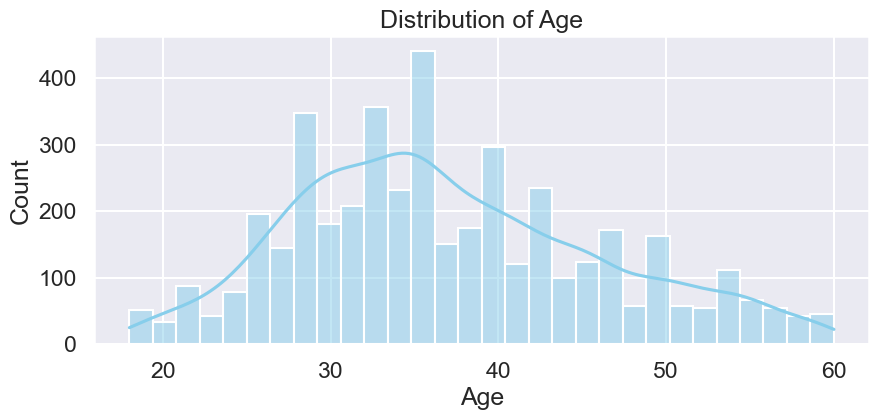

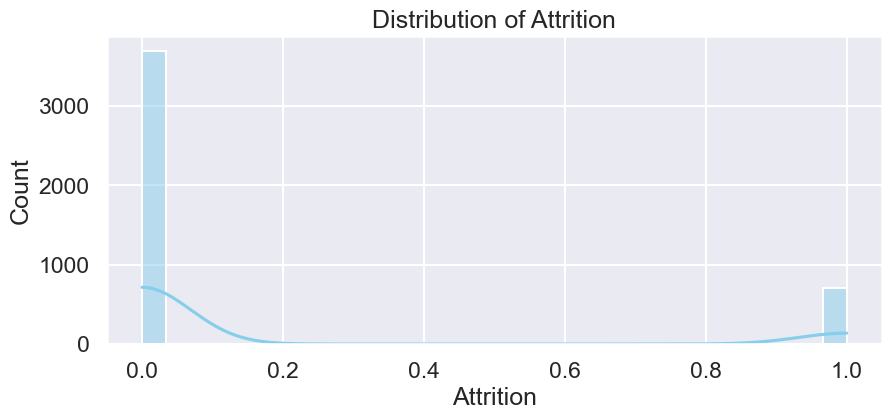

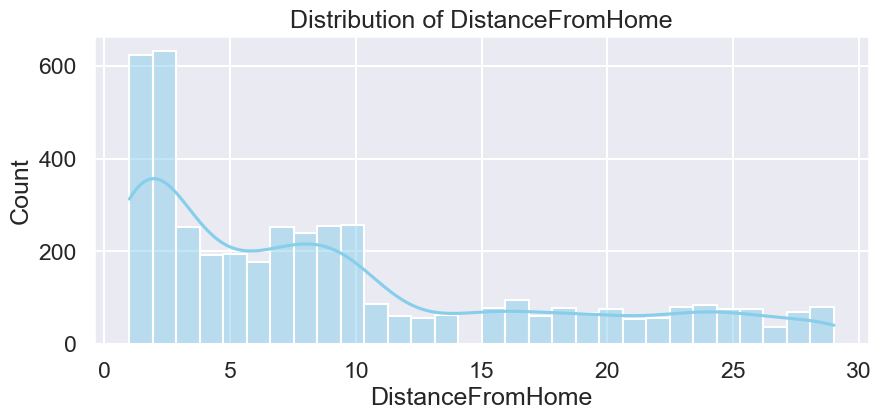

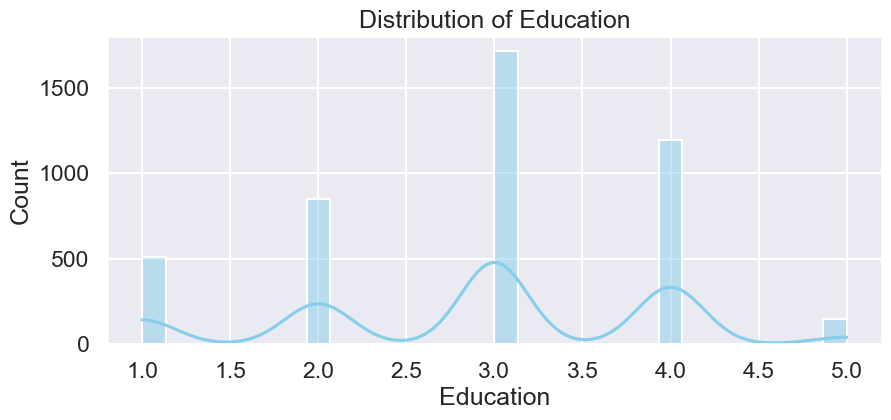

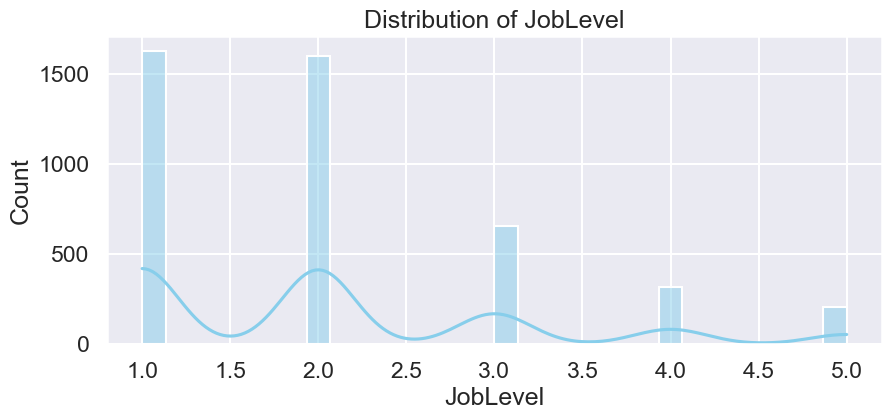

...

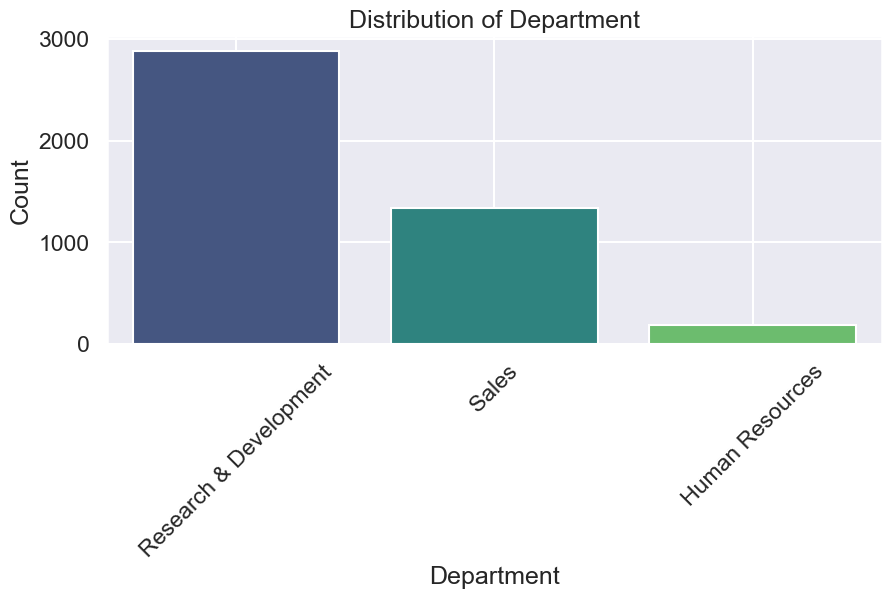

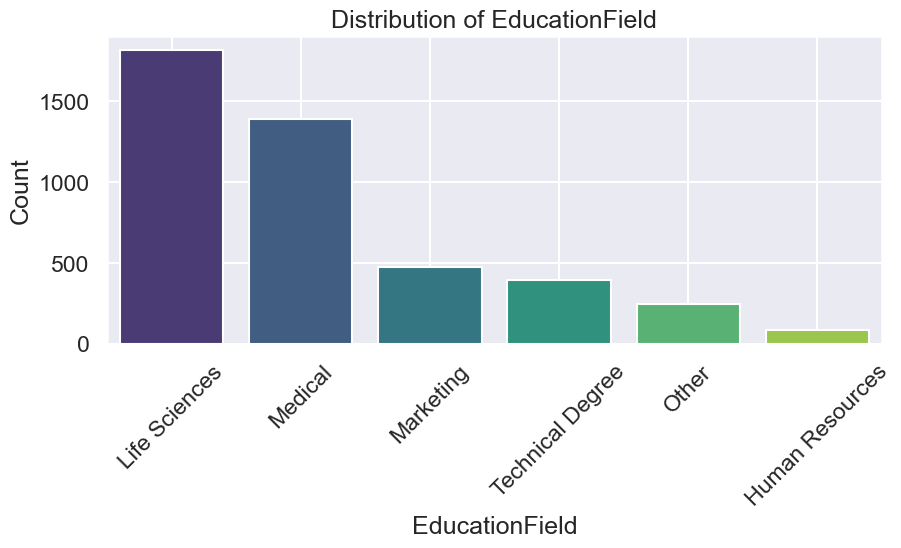

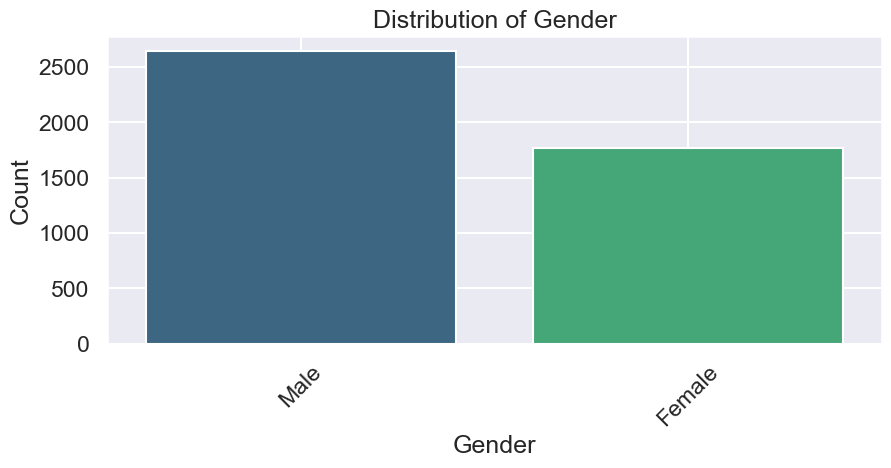

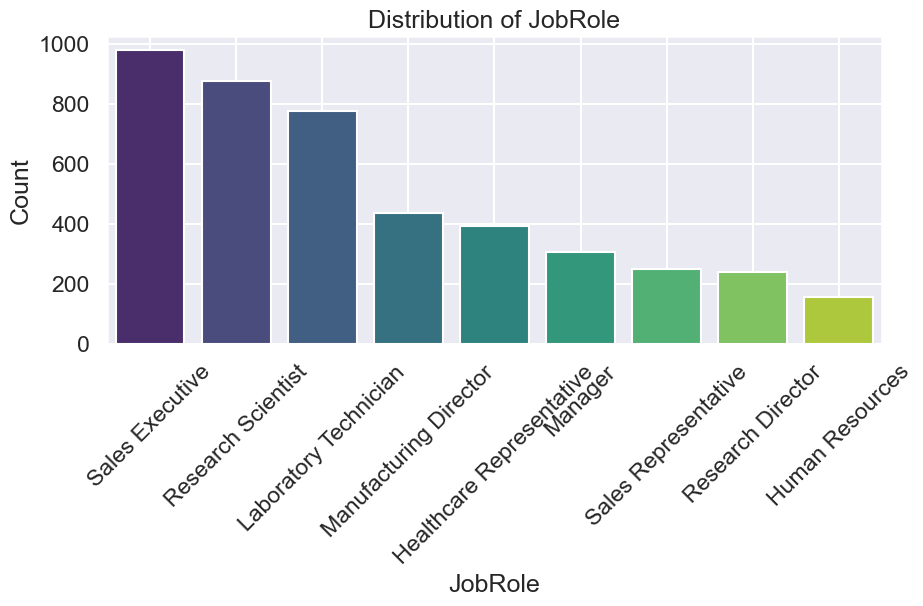

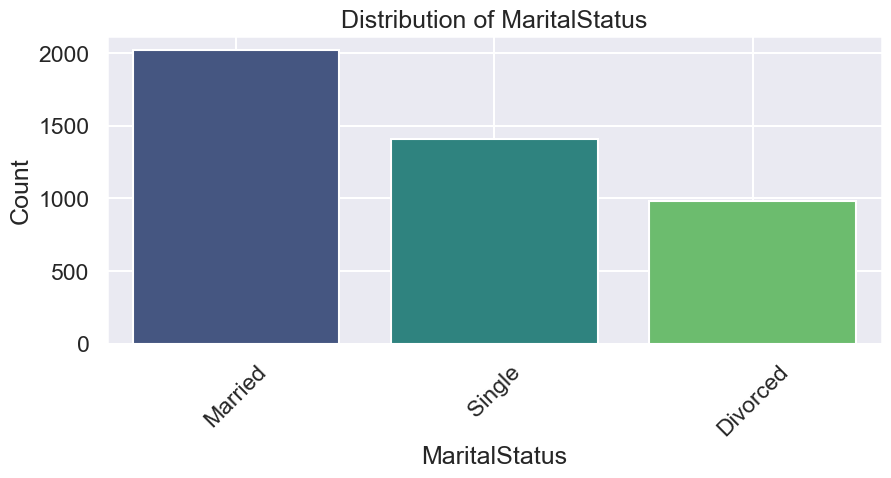

In [20]:

# Suppression des colonnes entièrement vides
df = df.dropna(axis=1, how='all')

# Univariate analysis for numerical features
numerical_columns = df.select_dtypes(include=['float64', 'int64']).columns
for column in numerical_columns:
    # Skip columns with too many unique values (e.g., IDs)
    #if df[column].nunique() > 50:
        #print(f"Skipping {column}: too many unique values ({df[column].nunique()})")
        #continue
    
    plt.figure(figsize=(10, 4))
    sns.histplot(df[column], kde=True, bins=30, color='skyblue')  # Use histogram with KDE for numerical data
    plt.title(f'Distribution of {column}')
    plt.xlabel(column)
    plt.ylabel('Count')
    plt.grid(True)
    plt.show()

# Univariate analysis for categorical features
categorical_columns = df.select_dtypes(include=['object']).columns
for column in categorical_columns:
    if df[column].nunique() > 20:  # Avoid cluttered graphs for columns with too many unique values
        print(f"Skipping {column}: too many unique categories ({df[column].nunique()})")
        continue
    
    plt.figure(figsize=(10, 4))
    sns.countplot(x=df[column], palette='viridis', order=df[column].value_counts().index)
    plt.title(f'Distribution of {column}')
    plt.xlabel(column)
    plt.ylabel('Count')
    plt.xticks(rotation=45)
    plt.grid(True)
    plt.show()


### Bivariate Analysis

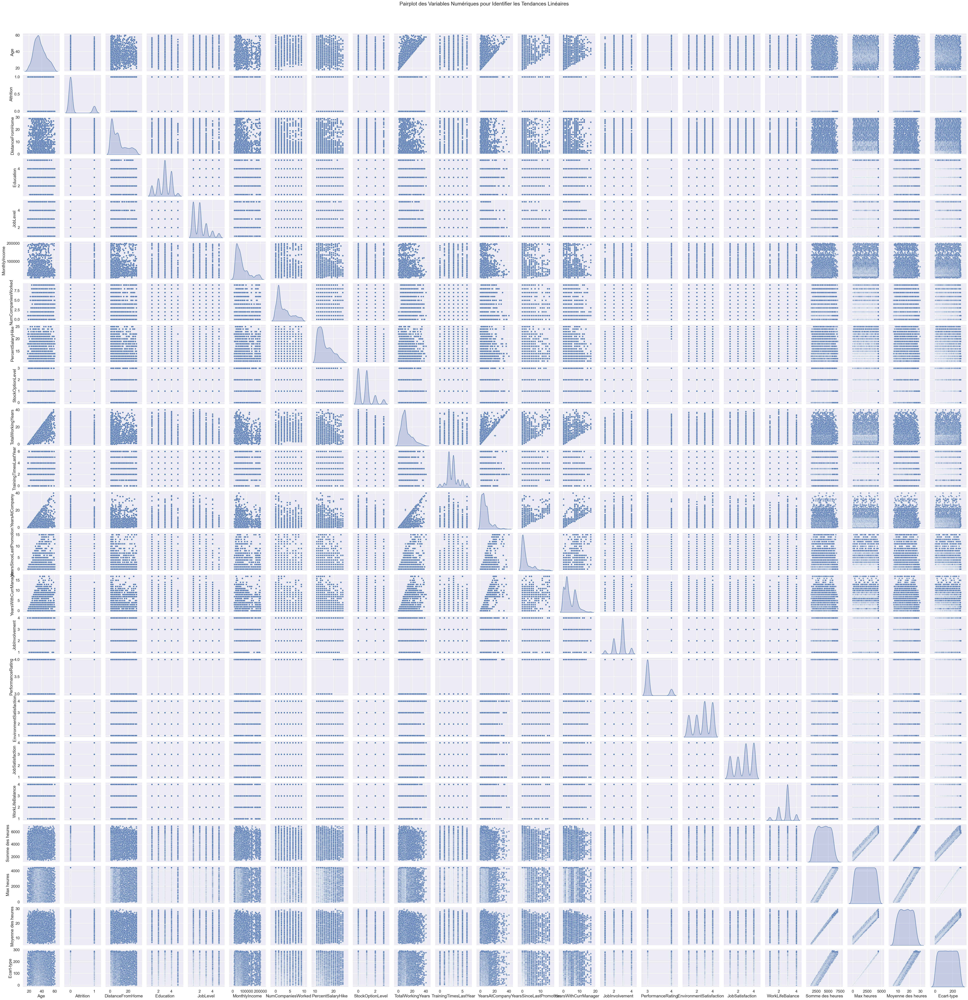

In [21]:
# Filtrer les colonnes numériques
numerical_data = df.select_dtypes(include=['float64', 'int64'])

# Générer le pairplot
sns.pairplot(
    numerical_data, 
    kind="scatter", 
    diag_kind="kde", 
    plot_kws={'alpha': 0.7, 's': 40},  # Ajuste la transparence et la taille des points
    diag_kws={'shade': True}  # Ajoute un ombrage aux courbes de densité
)

# Titre global
plt.suptitle("Pairplot des Variables Numériques pour Identifier les Tendances Linéaires", y=1.02)
plt.show()


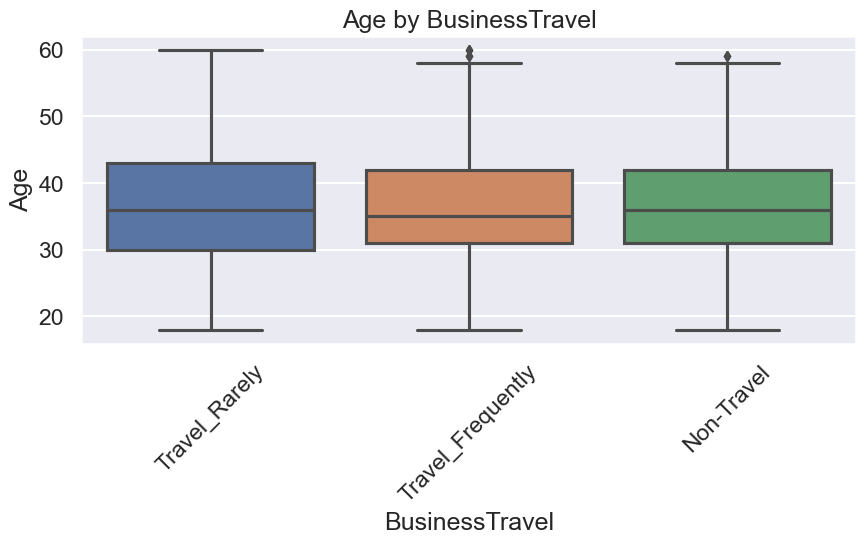

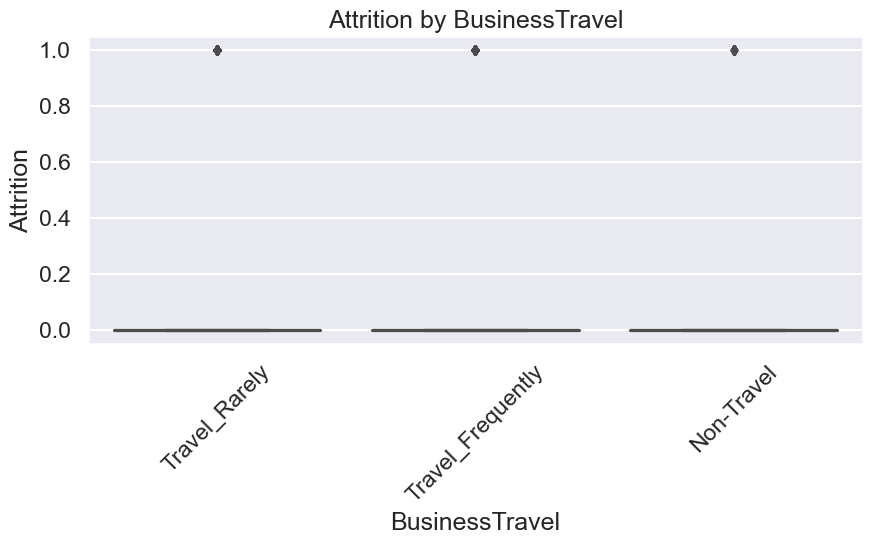

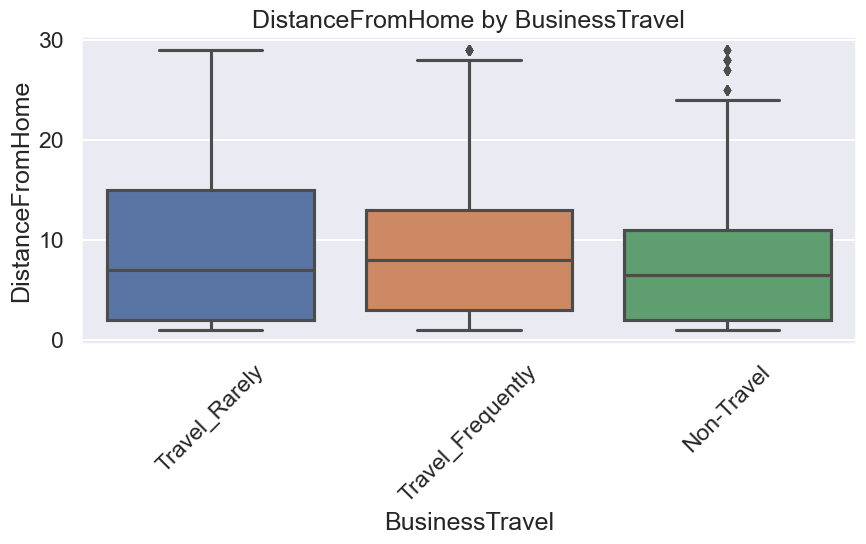

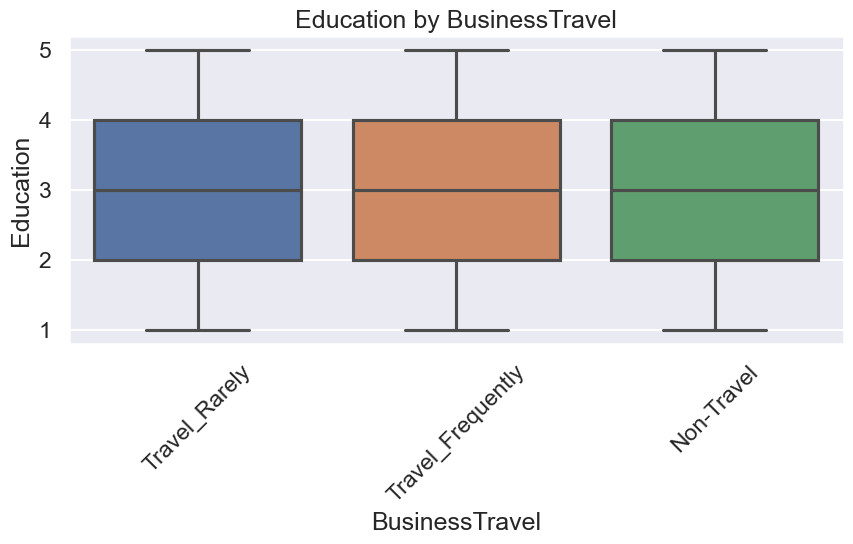

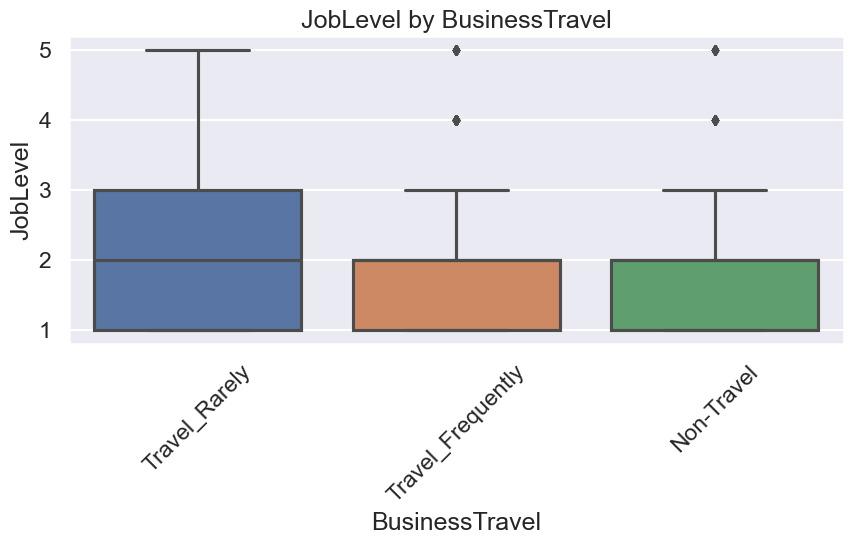

...

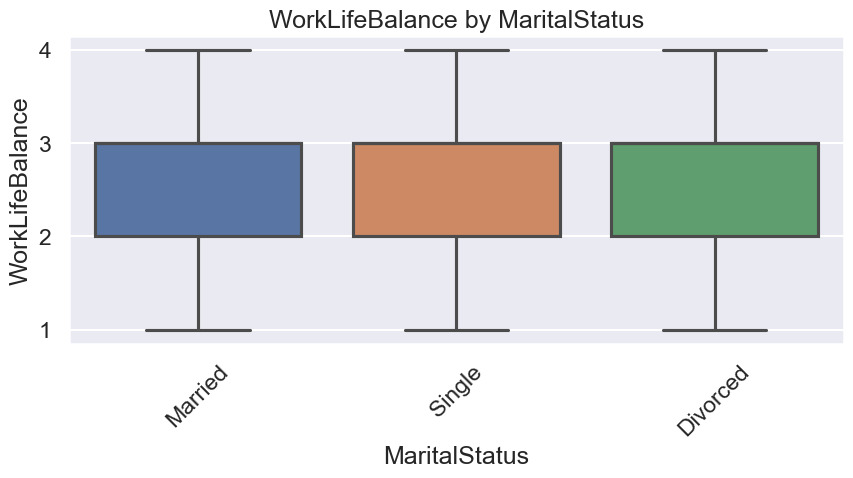

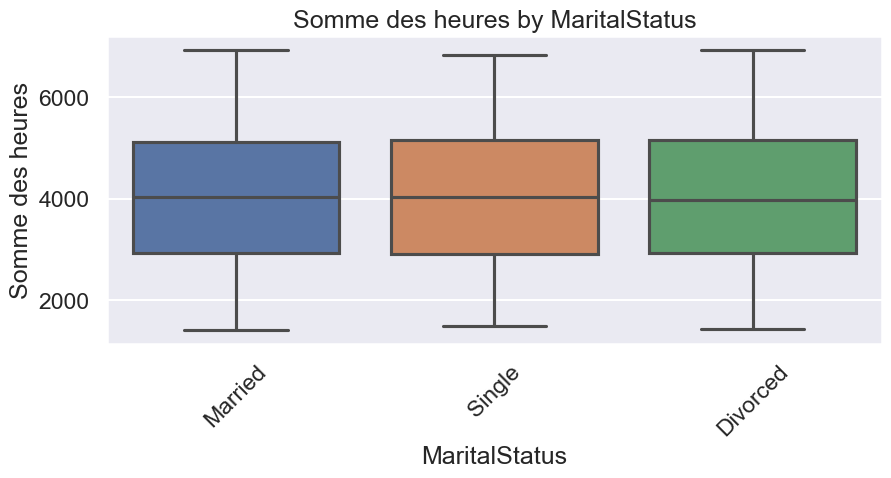

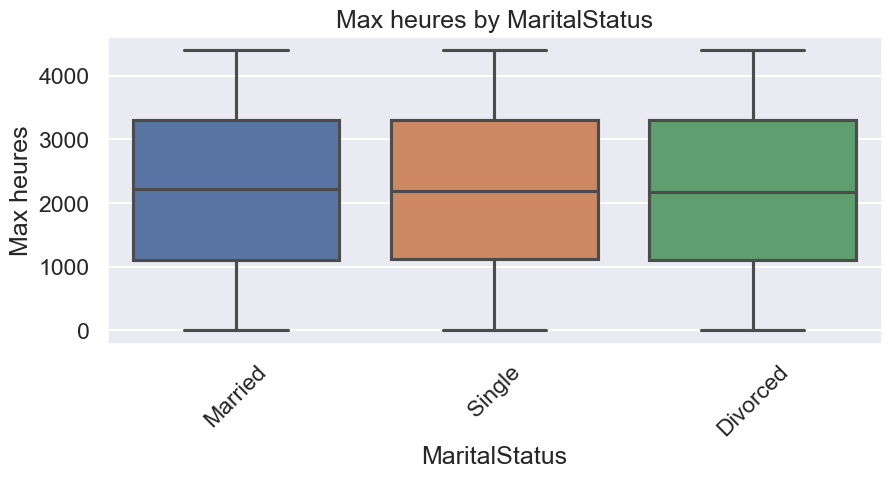

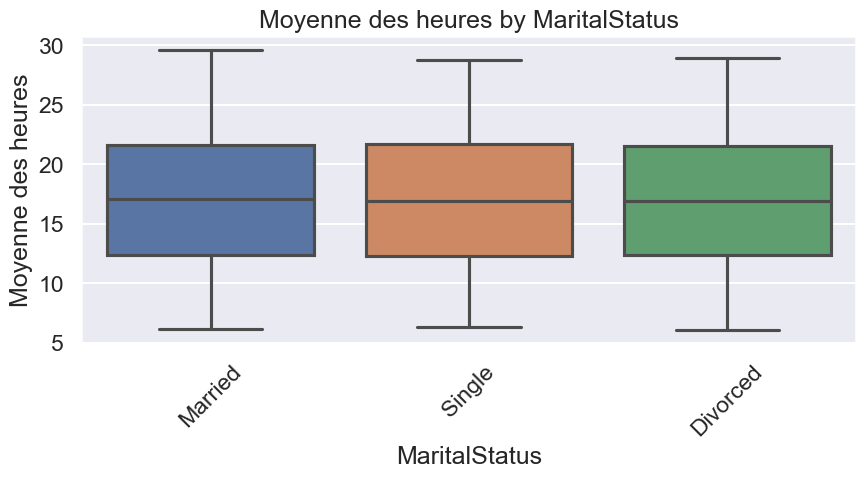

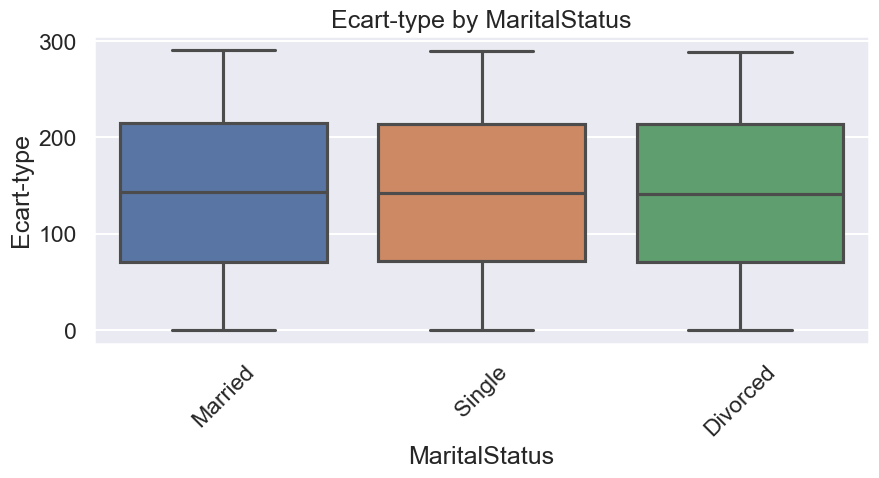

In [22]:
# Box plots for categorical vs numerical features
for categorical_column in categorical_columns:
    for column in numerical_columns:
        plt.figure(figsize=(10, 4))
        sns.boxplot(x=df[categorical_column], y=df[column])
        plt.title(f'{column} by {categorical_column}')
        plt.xticks(rotation=45)  # Si nécessaire pour améliorer la lisibilité
        plt.show()

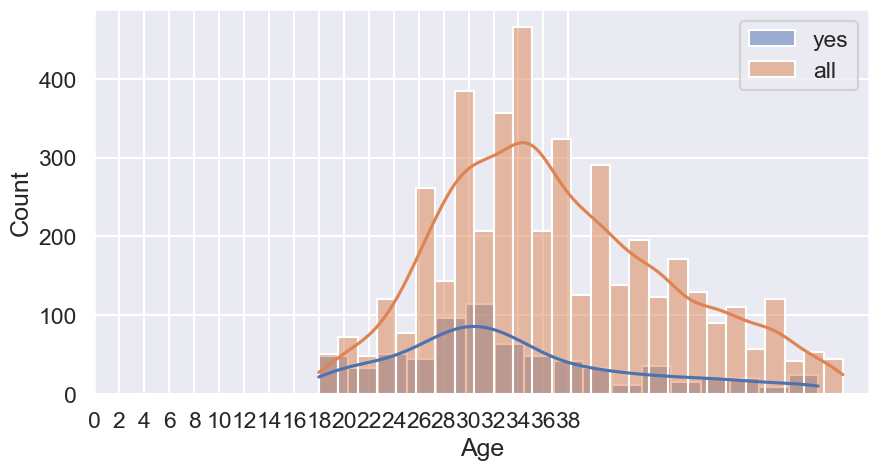

In [23]:
ax=plt.figure(figsize=(10,5))
sns.histplot(df[df['Attrition']==1].Age,label='yes', kde=True)
sns.histplot(df.Age,label='all', kde = True)
plt.xticks(range(0,40,2))
plt.legend()
plt.show()

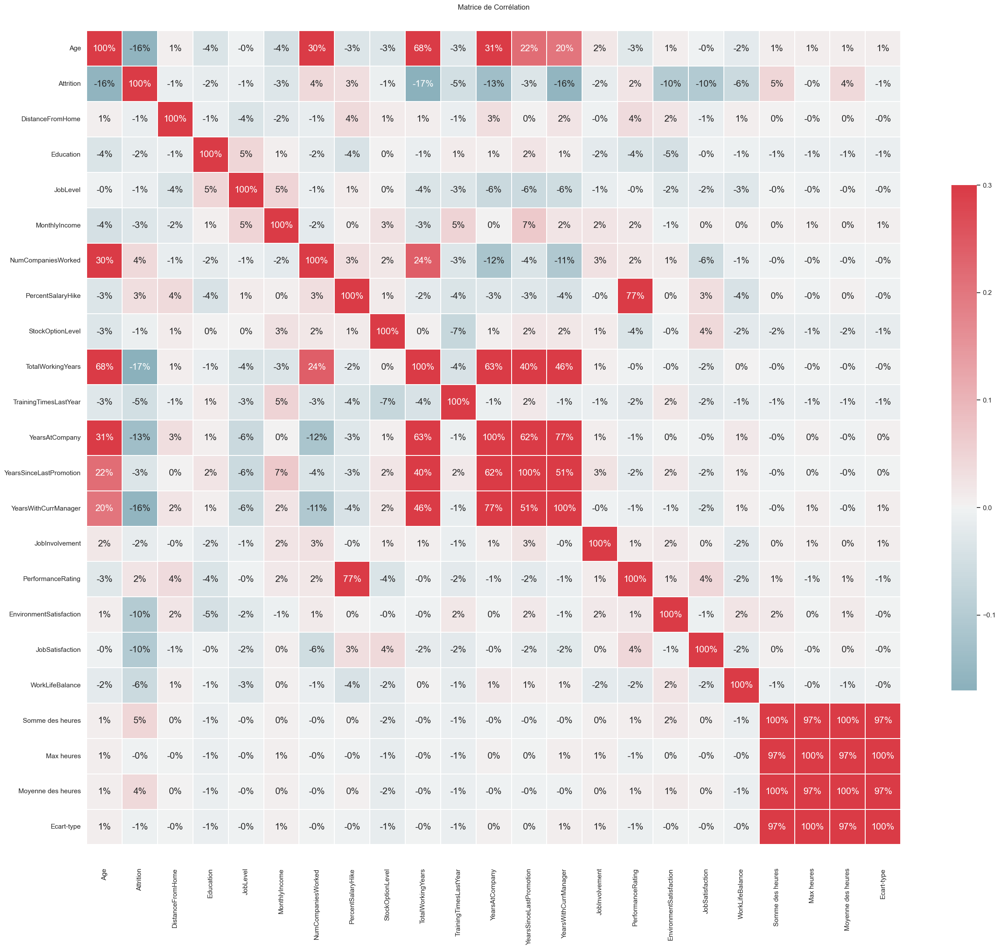

In [24]:
sns.set(style="white")
corr = numerical_data.corr()
mask = np.triu(np.ones_like(corr, dtype=bool))
f, ax = plt.subplots(figsize=(30, 30))
cmap = sns.diverging_palette(220, 10, as_cmap=True)
cm = sns.heatmap(corr, cmap=cmap, vmax=.3, center=0,annot=True, fmt=".0%", square=True, linewidths=.1, cbar_kws={"shrink": .5}, annot_kws={"size": 15})
bottom, top = cm.get_ylim()
cm.set_ylim(bottom + 0.5, top - 0.5)
plt.title('Matrice de Corrélation')
plt.show()

#### Les facteurs les plus corrélés avec la rotation sont :
- MaritalStatus (statut marital).
- EnvironmentSatisfaction (satisfaction de l'environnement de travail).
- JobSatisfaction (satisfaction au travail).
- YearsAtCompany (ancienneté dans l'entreprise)
- YearsWithCurrManager (années avec le manager actuel).
- Age (âge).
- TotalWorkingYears (années d'expérience totales).


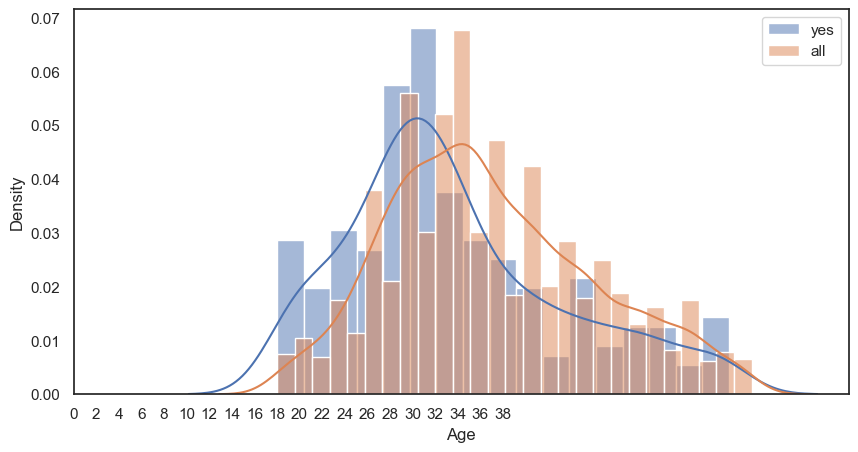

In [25]:
ax=plt.figure(figsize=(10,5))
sns.histplot(df[df['Attrition']==1].Age,label='yes', kde=True,stat="density",kde_kws=dict(cut=3))
sns.histplot(df.Age,label='all', kde=True,stat="density",kde_kws=dict(cut=3))
plt.xticks(range(0,40,2))
plt.legend()
plt.show()

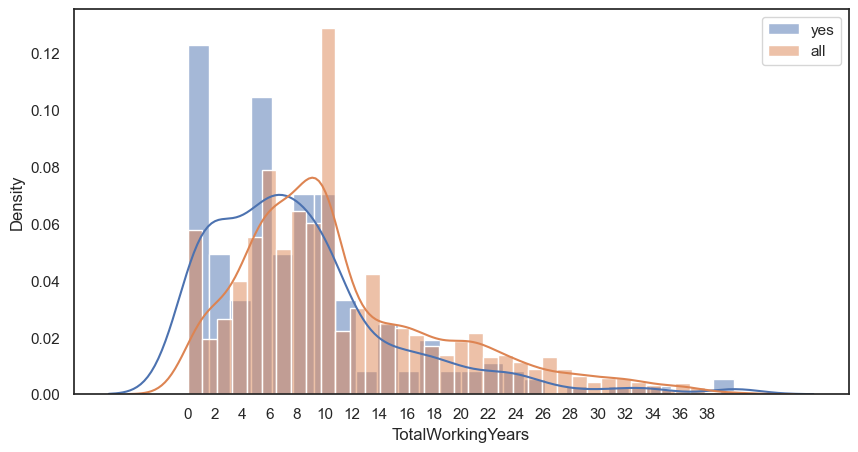

In [26]:
ax=plt.figure(figsize=(10,5))
sns.histplot(df[df['Attrition']==1].TotalWorkingYears,label='yes', kde=True,stat="density",kde_kws=dict(cut=3))
sns.histplot(df.TotalWorkingYears,label='all', kde=True,stat="density",kde_kws=dict(cut=3))
plt.xticks(range(0,40,2))
plt.legend()
plt.show()

In [27]:
pd.crosstab(df['Attrition'],df['MaritalStatus'],margins=True,normalize=True)

MaritalStatus,Divorced,Married,Single,All
Attrition,,,,
0,0.20,0.40,0.24,0.84
1,0.02,0.06,0.08,0.16
All,0.22,0.46,0.32,1.00


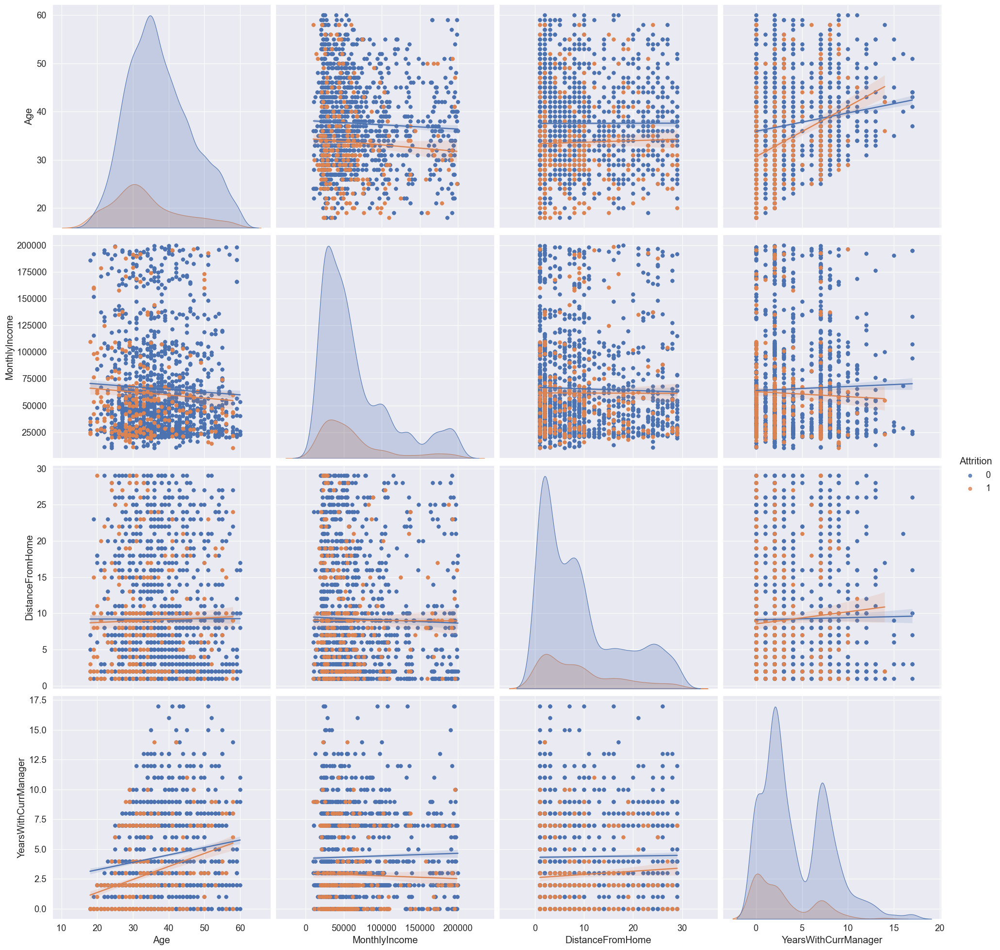

In [28]:
sns.set(context="paper", font_scale=1.5)
sns.pairplot(df[['Age','MonthlyIncome','DistanceFromHome','YearsWithCurrManager','Attrition']],hue = 'Attrition', height = 5, kind="reg")
plt.show()

1. **16% des employés ont quitté l'année dernière** :
   - C'est un taux de rotation significatif. Cela justifie l'importance de ce projet pour aider l'entreprise à mieux comprendre les facteurs d'attrition et potentiellement réduire ce taux.

2. **60% des employés sont des hommes** :
   - Ce ratio indique une potentielle disparité de genre dans l'entreprise. 

3. **La plupart des employés ont entre 30 et 38 ans** :
   - Cela peut indiquer une tranche d'âge dominante dans l'entreprise. 

4. **Les employés qui partent sont généralement plus jeunes**

5. **Les variables les plus influentes sur l'attrition** :
   - **MaritalStatus, EnvironmentSatisfaction, JobSatisfaction, YearsAtCompany, YearsWithCurrManager, Age, TotalWorkingYears** :
     - Cela fait sens, car ces variables peuvent influencer la décision des employés de quitter une entreprise. Les employés ayant une faible satisfaction au travail ou un mauvais environnement de travail sont plus susceptibles de partir.
     - L'ancienneté et le nombre d'années avec le même manager sont également des facteurs cruciaux : un employé avec plus d'expérience pourrait avoir plus de raisons de partir pour de nouvelles opportunités, tandis qu'un employé avec un manager stable pourrait être moins susceptible de partir.
     - L'âge et l'expérience totale sont des indicateurs de maturité professionnelle et peuvent avoir un impact sur l'attrition (par exemple, un employé plus âgé pourrait avoir plus de raisons de rester dans une entreprise stable).

6. **Les employés qui partent ont une satisfaction au travail plutôt faible, tandis que la satisfaction de l'environnement de travail varie** :
   - Cela met en lumière l'importance d'améliorer la satisfaction au travail pour réduire l'attrition. C'est une piste d'action concrète pour l'entreprise : améliorer la satisfaction des employés dans leur travail quotidien pourrait avoir un impact direct sur la rétention.

7. **Relation faible entre l'attrition et PerformanceRating ou JobInvolvement** :
   - Ce point est intéressant car il suggère que l'attrition ne semble pas être directement liée à la performance des employés ou à leur implication dans le travail. Cela pourrait signifier que des facteurs externes (comme la culture d'entreprise ou des opportunités de carrière externes) influencent plus fortement l'attrition que la performance individuelle.

8. **Les employés célibataires sont plus susceptibles de partir** :
   - Cette observation est également pertinente et pourrait être un facteur important dans le modèle prédictif. Les employés célibataires pourraient avoir moins d'attachements personnels à l'entreprise (par exemple, moins de responsabilités familiales), ce qui pourrait les rendre plus ouverts à de nouvelles opportunités.


- Les résultats de l'EDA fournissent des pistes solides pour la modélisation prédictive et la réduction de l'attrition.

Vous avez raison, l'anonymat des données fournies est un point positif qui réduit certains risques éthiques. Cependant, l'éthique dans un projet d'IA va au-delà de l'anonymat des données. Voici une clarification des points éthiques qui restent pertinents, même avec des données anonymisées :

---


#### **Traitement des Horaires d'Entrée et de Sortie**
- **Objectif** : Calculer des statistiques sur les heures travaillées par chaque employé.
- **Éthique** :
  - **Transparence** : Les horaires d'entrée et de sortie ont été convertis en format `datetime` pour faciliter les calculs. Les statistiques (somme, moyenne, écart-type) ont été calculées pour chaque employé.
  - **Justification** : Ces statistiques ont été calculées pour identifier si les horaires irréguliers influencent l'attrition, ce qui est pertinent pour améliorer la satisfaction au travail.

---

#### **Identification des Types de Données**
- **Objectif** : Classifier les variables en numériques et catégorielles.
- **Éthique** :
  - **Évitement des biais** : Les variables comme `Gender` et `MaritalStatus` ont été traitées avec précaution pour éviter toute utilisation discriminatoire.
  - **Transparence** : Les variables catégorielles ont été identifiées et seront encodées pour être utilisées dans les modèles.

---

#### **Vérification des Valeurs Manquantes**
- **Objectif** : Identifier et gérer les valeurs manquantes.
- **Éthique** :
  - **Transparence** : Les valeurs manquantes dans `EnvironmentSatisfaction` et `JobSatisfaction` ont été imputées par la médiane pour préserver la distribution des données.
  - **Justification** : L'imputation par la médiane a été choisie pour éviter les biais et préserver la confidentialité des données.

---

#### **Univariate Analysis**
- **Objectif** : Analyser la distribution des variables individuelles.
- **Éthique** :
  - **Respect de la confidentialité** : Les résultats de l'analyse ne révèlent pas d'informations sensibles sur des employés individuels.
  - **Transparence** : Les résultats montrent que 16 % des employés ont quitté l'entreprise, et que la plupart des employés ont entre 30 et 38 ans.

---

#### **Bivariate Analysis**
- **Objectif** : Analyser les relations entre les variables et l'attrition.
- **Éthique** :
  - **Évitement des biais** : L'analyse a été effectuée pour éviter les biais, notamment en ce qui concerne le genre et le statut marital.
  - **Transparence** : Les résultats montrent que les employés célibataires sont plus susceptibles de partir, mais cela ne signifie pas que le statut marital est une cause directe de l'attrition.
  - **Analyse des implications éthiques** : Les résultats suggèrent que les employés célibataires pourraient avoir moins d'attachements personnels à l'entreprise, mais il est important de ne pas interpréter cela comme une discrimination.



---

## 4. Préparation des Données
---

In [29]:
# Sélection des colonnes numériques
df_num = df.select_dtypes(include=['float64', 'int64']).drop(columns = ['Attrition'])
# Normalisation des colonnes numériques
scaler = StandardScaler()
df_num_scaled = pd.DataFrame(scaler.fit_transform(df_num), columns=df_num.columns)

# Vérification de la normalisation
df_num_scaled.head()

,Age,DistanceFromHome,Education,JobLevel,MonthlyIncome,NumCompaniesWorked,PercentSalaryHike,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,YearsAtCompany,YearsSinceLastPromotion,YearsWithCurrManager,JobInvolvement,PerformanceRating,EnvironmentSatisfaction,JobSatisfaction,WorkLifeBalance,Somme des heures,Max heures,Moyenne des heures,Ecart-type
0,1.54,-0.39,-0.89,-0.96,1.41,-0.68,-1.15,-0.93,-1.32,2.48,-0.98,-0.68,-1.16,0.38,-0.43,0.25,1.16,-1.09,-1.76,-1.73,-1.75,-1.72
1,-0.65,0.10,-1.87,-0.96,-0.49,-1.08,2.13,0.24,-0.68,0.16,-0.33,-0.37,-0.03,-1.03,2.35,0.25,-0.66,1.76,-1.68,-1.73,-1.68,-1.72
2,-0.54,0.96,1.06,1.75,2.73,-0.68,-0.06,2.59,-0.81,-0.62,-0.33,-0.68,-0.31,0.38,-0.43,-0.67,-0.66,-2.51,-1.77,-1.73,-1.81,-1.72
3,0.12,-0.89,2.04,0.85,0.39,0.12,-1.15,2.59,0.22,1.71,0.16,1.49,0.25,-1.03,-0.43,1.17,1.16,0.34,-1.78,-1.73,-1.78,-1.72
4,-0.54,0.10,-1.87,-0.96,-0.88,0.52,-0.88,1.42,-0.29,-0.62,-0.16,-0.68,-0.03,0.38,-0.43,1.17,-1.57,0.34,-1.57,-1.73,-1.63,-1.72


In [30]:
# Sélection des colonnes catégorielles
df_cat = df.select_dtypes(include=[object])

# Encodage one-hot des variables catégorielles
encoder = OneHotEncoder()
df_cat_encoded = pd.DataFrame(encoder.fit_transform(df_cat).toarray(), columns=encoder.get_feature_names_out(df_cat.columns))

# Vérification du résultat de l'encodage
df_cat_encoded.head()

,BusinessTravel_Non-Travel,BusinessTravel_Travel_Frequently,BusinessTravel_Travel_Rarely,Department_Human Resources,Department_Research & Development,Department_Sales,EducationField_Human Resources,EducationField_Life Sciences,EducationField_Marketing,EducationField_Medical,EducationField_Other,EducationField_Technical Degree,Gender_Female,Gender_Male,JobRole_Healthcare Representative,JobRole_Human Resources,JobRole_Laboratory Technician,JobRole_Manager,JobRole_Manufacturing Director,JobRole_Research Director,JobRole_Research Scientist,JobRole_Sales Executive,JobRole_Sales Representative,MaritalStatus_Divorced,MaritalStatus_Married,MaritalStatus_Single
0,0.00,0.00,1.00,0.00,0.00,1.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00
1,0.00,1.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00
2,0.00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00
3,1.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00
4,0.00,0.00,1.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,1.00


In [31]:
df_prepared = pd.concat([df_num_scaled, df_cat_encoded], axis=1)
df_prepared['Attrition'] = df['Attrition']

df_prepared['DistanceIncomeRatio'] = df_prepared['DistanceFromHome'] / df_prepared['MonthlyIncome']
df_prepared['PromotionGap'] = df_prepared['YearsAtCompany'] - df_prepared['YearsSinceLastPromotion']
df_prepared['OverallSatisfaction'] = df_prepared['JobSatisfaction'] + df_prepared['EnvironmentSatisfaction']
df_prepared['ExperienceRatio'] = df_prepared['TotalWorkingYears'] / df_prepared['Age']
df['TrainingPerformance'] = df_prepared['TrainingTimesLastYear'] * df_prepared['PerformanceRating']
df_prepared['EducationValue'] = df_prepared['MonthlyIncome'] / df_prepared['Education']

# Vérification des données préparées
df_prepared.head()

,Age,DistanceFromHome,Education,JobLevel,MonthlyIncome,NumCompaniesWorked,PercentSalaryHike,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,YearsAtCompany,YearsSinceLastPromotion,YearsWithCurrManager,JobInvolvement,PerformanceRating,EnvironmentSatisfaction,JobSatisfaction,WorkLifeBalance,Somme des heures,Max heures,Moyenne des heures,Ecart-type,BusinessTravel_Non-Travel,BusinessTravel_Travel_Frequently,BusinessTravel_Travel_Rarely,Department_Human Resources,Department_Research & Development,Department_Sales,EducationField_Human Resources,EducationField_Life Sciences,EducationField_Marketing,EducationField_Medical,EducationField_Other,EducationField_Technical Degree,Gender_Female,Gender_Male,JobRole_Healthcare Representative,JobRole_Human Resources,JobRole_Laboratory Technician,JobRole_Manager,JobRole_Manufacturing Director,JobRole_Research Director,JobRole_Research Scientist,JobRole_Sales Executive,JobRole_Sales Representative,MaritalStatus_Divorced,MaritalStatus_Married,MaritalStatus_Single,Attrition,DistanceIncomeRatio,PromotionGap,OverallSatisfaction,ExperienceRatio,EducationValue
0,1.54,-0.39,-0.89,-0.96,1.41,-0.68,-1.15,-0.93,-1.32,2.48,-0.98,-0.68,-1.16,0.38,-0.43,0.25,1.16,-1.09,-1.76,-1.73,-1.75,-1.72,0.00,0.00,1.00,0.00,0.00,1.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0,-0.28,-0.30,1.41,-0.86,-1.58
1,-0.65,0.10,-1.87,-0.96,-0.49,-1.08,2.13,0.24,-0.68,0.16,-0.33,-0.37,-0.03,-1.03,2.35,0.25,-0.66,1.76,-1.68,-1.73,-1.68,-1.72,0.00,1.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,1,-0.20,0.04,-0.41,1.05,0.26
2,-0.54,0.96,1.06,1.75,2.73,-0.68,-0.06,2.59,-0.81,-0.62,-0.33,-0.68,-0.31,0.38,-0.43,-0.67,-0.66,-2.51,-1.77,-1.73,-1.81,-1.72,0.00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0,0.35,0.35,-1.33,1.50,2.57
3,0.12,-0.89,2.04,0.85,0.39,0.12,-1.15,2.59,0.22,1.71,0.16,1.49,0.25,-1.03,-0.43,1.17,1.16,0.34,-1.78,-1.73,-1.78,-1.72,1.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0,-2.30,-1.33,2.33,1.88,0.19
4,-0.54,0.10,-1.87,-0.96,-0.88,0.52,-0.88,1.42,-0.29,-0.62,-0.16,-0.68,-0.03,0.38,-0.43,1.17,-1.57,0.34,-1.57,-1.73,-1.63,-1.72,0.00,0.00,1.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,1.00,0,-0.11,0.51,-0.40,0.54,0.47


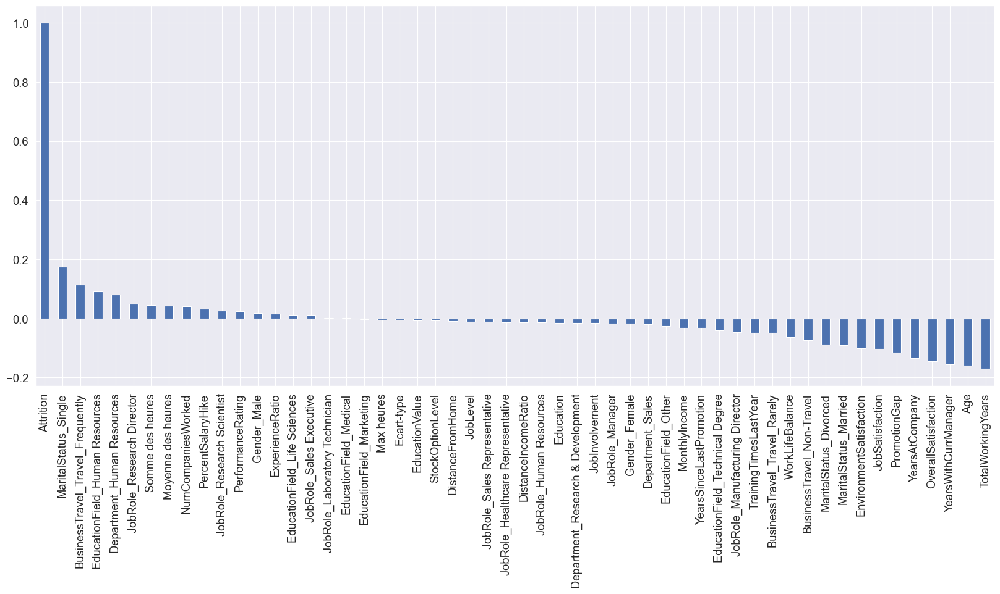

In [32]:
plt.figure(figsize=(20,8))
df_prepared.corr()['Attrition'].sort_values(ascending = False).plot(kind='bar');

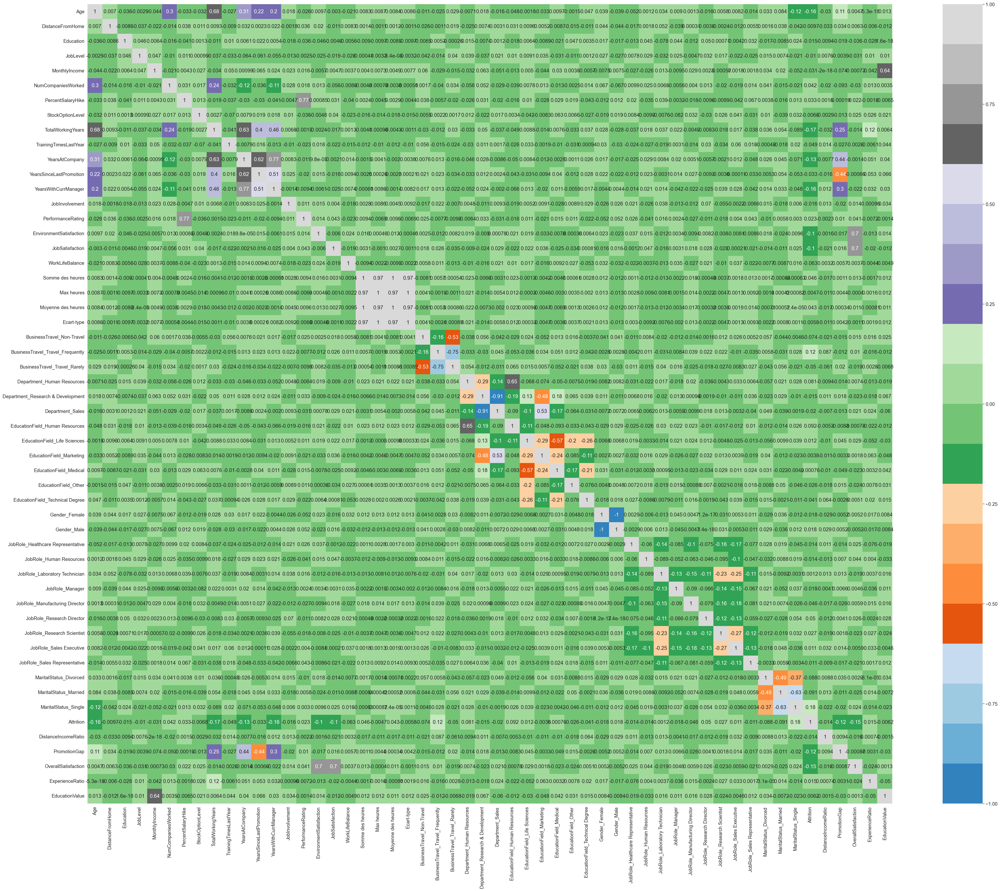

In [33]:
plt.figure(figsize = (50,40))   
sns.heatmap(df_prepared.corr(),annot = True,cmap="tab20c")
plt.show()

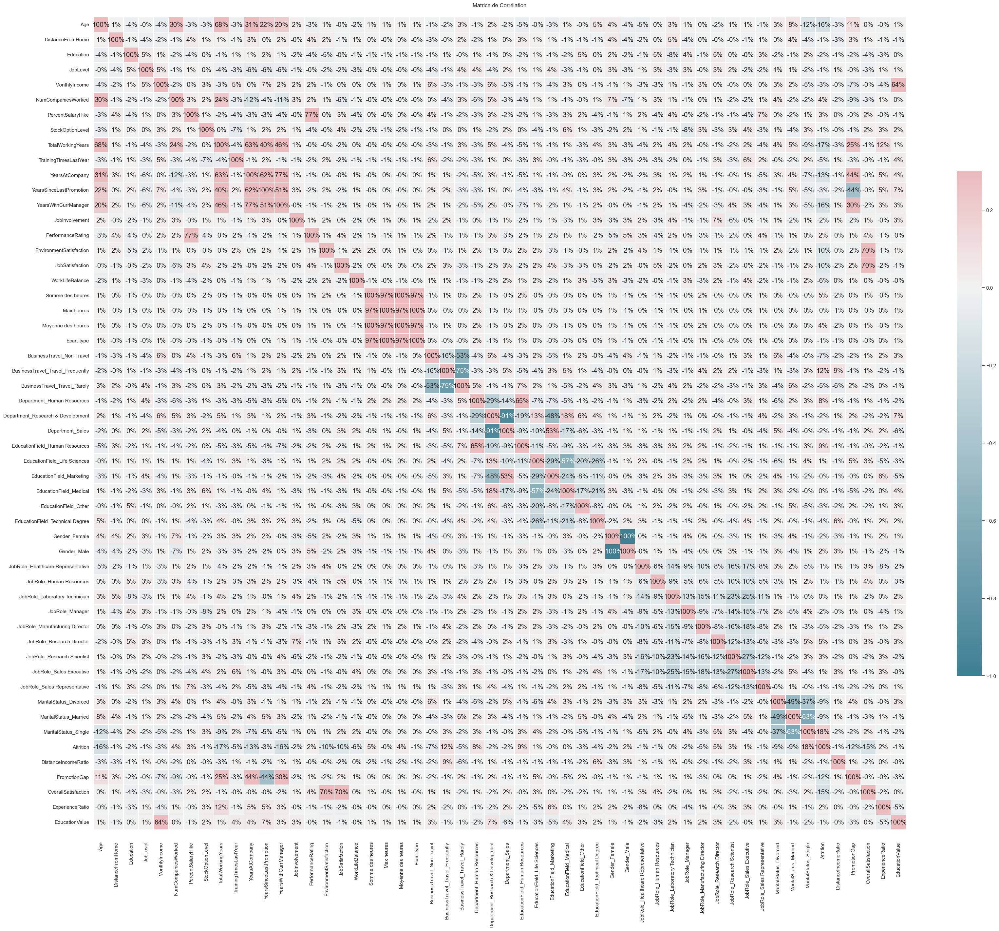

In [34]:
sns.set(style="white")
corr = df_prepared.corr()
mask = np.triu(np.ones_like(corr, dtype=bool))
f, ax = plt.subplots(figsize=(40, 40))
cmap = sns.diverging_palette(220, 10, as_cmap=True)
cm = sns.heatmap(corr, cmap=cmap, vmax=.3, center=0,annot=True, fmt=".0%", square=True, linewidths=.1, cbar_kws={"shrink": .5}, annot_kws={"size": 15})
bottom, top = cm.get_ylim()
cm.set_ylim(bottom + 0.5, top - 0.5)
plt.title('Matrice de Corrélation')
plt.show()

In [35]:
X = df_prepared.drop(['Attrition'], axis=1)
y = df_prepared['Attrition']

In [36]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=0.7, test_size=0.3, random_state=100)

In [37]:
corrmat = X_train.corr() 
corrdf = corrmat.where(np.triu(np.ones(corrmat.shape), k=1).astype(bool))
corrdf = corrdf.unstack().reset_index()
corrdf.columns = ['Var1', 'Var2', 'Correlation']
corrdf.dropna(subset = ['Correlation'], inplace = True)
corrdf['Correlation'] = round(corrdf['Correlation'], 2)
corrdf['Correlation'] = abs(corrdf['Correlation'])
matrix= corrdf.sort_values(by = 'Correlation', ascending = False).head(50)
matrix

,Var1,Var2,Correlation
1889,Gender_Male,Gender_Female,1.00
1078,Moyenne des heures,Somme des heures,1.00
1132,Ecart-type,Max heures,1.00
1133,Ecart-type,Moyenne des heures,0.97
1079,Moyenne des heures,Max heures,0.97
...,...,...,...
1780,EducationField_Technical Degree,EducationField_Medical,0.21
1510,EducationField_Human Resources,Department_Research & Development,0.19
2319,JobRole_Sales Executive,JobRole_Manufacturing Director,0.18
1241,BusinessTravel_Travel_Frequently,BusinessTravel_Non-Travel,0.17


In [38]:
unique=list(set(matrix.Var2))
len(unique)

27

In [39]:
X_test = X_test.drop(unique,1)
X_train = X_train.drop(unique,1)

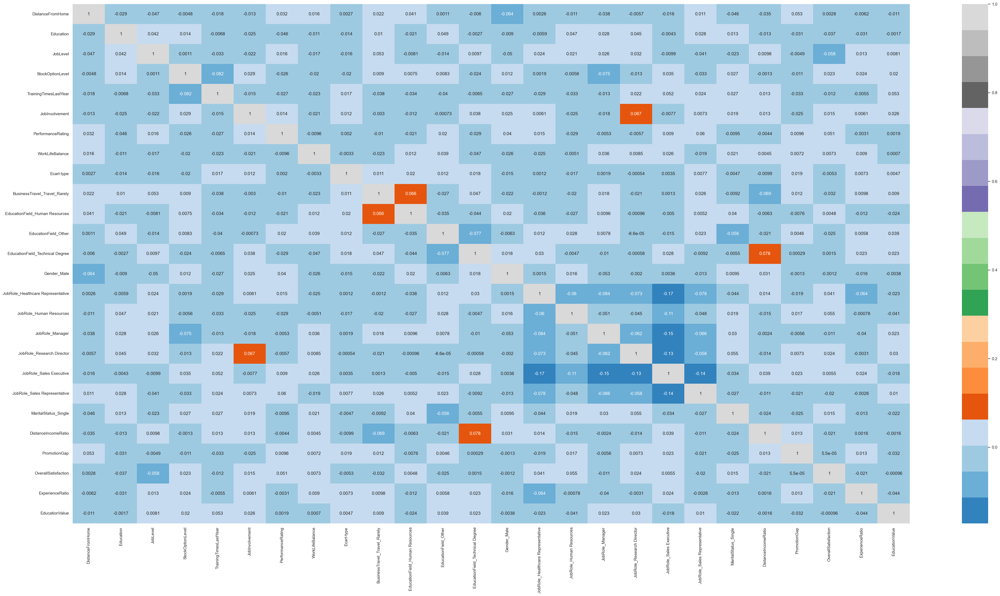

In [40]:
plt.figure(figsize = (50,25))
sns.heatmap(X_train.corr(),annot = True,cmap="tab20c")
plt.show()

## Application des modèles

###

In [41]:
from sklearn.linear_model import Perceptron, LogisticRegression
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier

models = {
    "Perceptron": Perceptron(),
    "LogisticRegression": LogisticRegression(max_iter=1000, random_state=42),
    "SVM": SVC(probability=True),
    "KNN": KNeighborsClassifier(),
    "NaiveBayes": GaussianNB(),
    "DecisionTree": DecisionTreeClassifier(random_state=42),
    "RandomForest": RandomForestClassifier(n_estimators=100, random_state=42)
}

# Entraînement et prédiction
predictions = {}
for name, model in models.items():
    model.fit(X_train, y_train)
    predictions[name] = model.predict(X_test)


In [68]:
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score, f1_score, roc_auc_score

# Fonction pour afficher les résultats
def display_metrics(y_test, y_pred, model_name):
    print(f"=== Résultats pour {model_name} ===")
    
    # Matrice de confusion
    print("Matrice de confusion :")
    print(confusion_matrix(y_test, y_pred))
    print()
    
    # Rapport de classification
    print("Rapport de classification :")
    print(classification_report(y_test, y_pred))
    
    # Précision et F1-score
    accuracy = accuracy_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred, average="weighted")  # Moyenne pondérée pour plusieurs classes
    print(f"Précision (Accuracy) : {accuracy:.2f}")
    print(f"F1 Score : {f1:.2f}")
    
    # Calcul et affichage de l'AUC-ROC (si applicable)
    if hasattr(models[model_name], "predict_proba"):
        y_proba = models[model_name].predict_proba(X_test)[:, 1]
        auc = roc_auc_score(y_test, y_proba)
        print(f"AUC-ROC : {auc:.2f}")
    else:
        print("AUC-ROC : Non applicable (le modèle ne supporte pas predict_proba).")
    
    print("=" * 50)

# Calcul des métriques pour chaque modèle
for name, y_pred in predictions.items():
    display_metrics(y_test, y_pred, name)


=== Résultats pour Perceptron ===
Matrice de confusion :
[[1018  107]
 [ 154   44]]

Rapport de classification :
              precision    recall  f1-score   support

           0       0.87      0.90      0.89      1125
           1       0.29      0.22      0.25       198

    accuracy                           0.80      1323
   macro avg       0.58      0.56      0.57      1323
weighted avg       0.78      0.80      0.79      1323

Précision (Accuracy) : 0.80
F1 Score : 0.79
AUC-ROC : Non applicable (le modèle ne supporte pas predict_proba).
=== Résultats pour LogisticRegression ===
Matrice de confusion :
[[1107   18]
 [ 192    6]]

Rapport de classification :
              precision    recall  f1-score   support

           0       0.85      0.98      0.91      1125
           1       0.25      0.03      0.05       198

    accuracy                           0.84      1323
   macro avg       0.55      0.51      0.48      1323
weighted avg       0.76      0.84      0.78      1323



C:\Users\Junior\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Junior\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Junior\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


AUC-ROC : 0.66
=== Résultats pour KNN ===
Matrice de confusion :
[[1082   43]
 [ 132   66]]

Rapport de classification :
              precision    recall  f1-score   support

           0       0.89      0.96      0.93      1125
           1       0.61      0.33      0.43       198

    accuracy                           0.87      1323
   macro avg       0.75      0.65      0.68      1323
weighted avg       0.85      0.87      0.85      1323

Précision (Accuracy) : 0.87
F1 Score : 0.85
AUC-ROC : 0.88
=== Résultats pour NaiveBayes ===
Matrice de confusion :
[[842 283]
 [ 95 103]]

Rapport de classification :
              precision    recall  f1-score   support

           0       0.90      0.75      0.82      1125
           1       0.27      0.52      0.35       198

    accuracy                           0.71      1323
   macro avg       0.58      0.63      0.58      1323
weighted avg       0.80      0.71      0.75      1323

Précision (Accuracy) : 0.71
F1 Score : 0.75
AUC-ROC : 0.6

### Perceptron :
- **Accuracy** : 80 % — correct mais pas excellent.
- **Recall (classe 1)** : 22 % — faible, ce qui signifie que le modèle ne détecte pas bien les employés susceptibles de partir.
- **F1 Score (classe 1)** : 0.25 — peu performant pour la classe minoritaire.
- **Conclusion** : Ce modèle n'est pas adapté pour ce problème en raison de son incapacité à gérer efficacement les classes déséquilibrées.

### Logistic Regression :
- **Accuracy** : 84 % — légèrement meilleur que le Perceptron.
- **AUC-ROC** : 0.72 — acceptable.
- **F1 Score (classe 1)** : 0.05 — très faible pour la classe minoritaire.
- **Conclusion** : Bien que l'accuracy soit élevée, le modèle ne capture pas efficacement la classe "Attrition".

### SVM :
- **Accuracy** : 85 % — bonne.
- **AUC-ROC** : 0.66 — médiocre.
- **F1 Score (classe 1)** : 0.00 — le modèle ne détecte pas du tout les employés partants.
- **Conclusion** : Non adapté, probablement en raison de l'absence de gestion de classes déséquilibrées.

### KNN :
- **Accuracy** : 87 % — solide.
- **AUC-ROC** : 0.88 — bon.
- **F1 Score (classe 1)** : 0.43 — meilleur équilibre pour les deux classes.
- **Conclusion** : KNN montre un bon compromis entre précision globale et détection des employés susceptibles de partir.

### Naive Bayes :
- **Accuracy** : 71 % — faible.
- **AUC-ROC** : 0.65 — médiocre.
- **F1 Score (classe 1)** : 0.35 — correct mais insuffisant.
- **Conclusion** : Performance globale décevante, probablement due à l'hypothèse d'indépendance des variables.

### Decision Tree :
- **Accuracy** : 96 % — excellente.
- **AUC-ROC** : 0.94 — excellente.
- **F1 Score (classe 1)** : 0.88 — très bon équilibre entre précision et rappel.
- **Conclusion** : Très performant pour ce problème, même sans réglage approfondi.

### Random Forest :
- **Accuracy** : 98 % — exceptionnelle.
- **AUC-ROC** : 0.99 — exceptionnelle.
- **F1 Score (classe 1)** : 0.93 — excellent équilibre.
- **Conclusion** : Meilleur modèle parmi tous les testés. Très performant sur les deux classes.


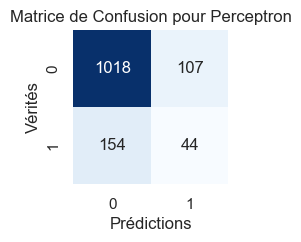

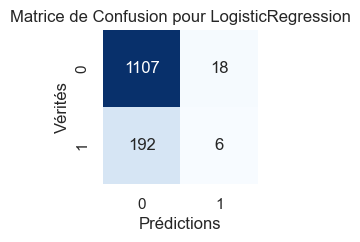

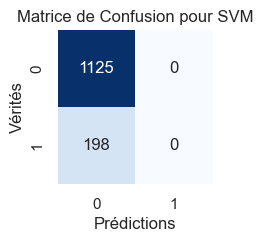

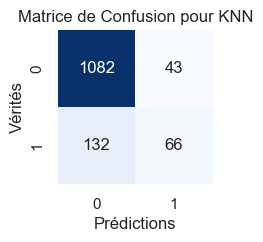

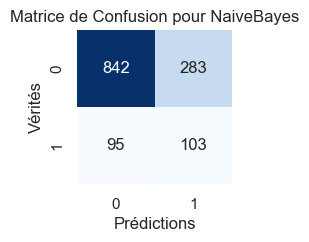

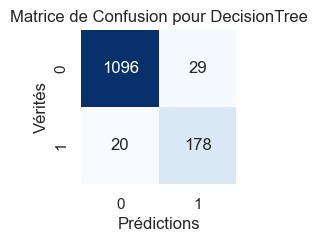

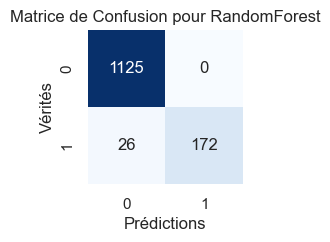

In [66]:
import seaborn as sns
from sklearn.metrics import confusion_matrix

for name, y_pred in predictions.items():
    # Calcul de la matrice de confusion
    conf_matrix = confusion_matrix(y_test, y_pred)
    
    # Tracé avec Seaborn
    plt.figure(figsize=(2, 2))
    sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', cbar=False)
    plt.title(f"Matrice de Confusion pour {name}")
    plt.xlabel("Prédictions")
    plt.ylabel("Vérités")
    plt.show()

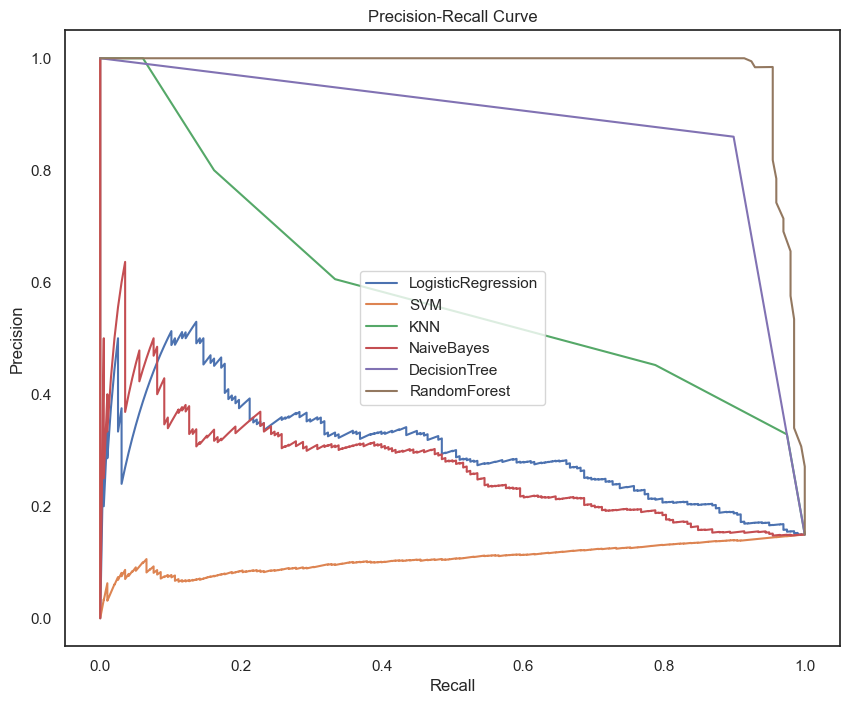

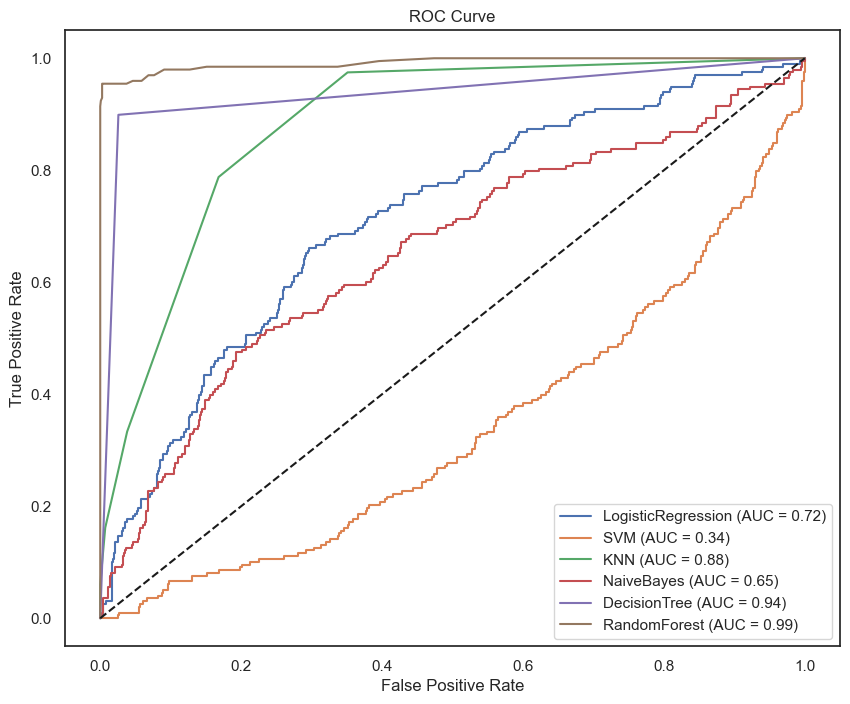

In [44]:
import matplotlib.pyplot as plt
from sklearn.metrics import precision_recall_curve, roc_curve, roc_auc_score

# Tracer les courbes de Précision-Rappel
plt.figure(figsize=(10, 8))

for name, model in models.items():
    if hasattr(model, "predict_proba"):
        # Probabilités prédites pour la classe positive
        y_proba = model.predict_proba(X_test)[:, 1]
        precision, recall, _ = precision_recall_curve(y_test, y_proba)
        plt.plot(recall, precision, label=f"{name}")

plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve')
plt.legend()
plt.show()

# Tracer les courbes ROC
plt.figure(figsize=(10, 8))

for name, model in models.items():
    if hasattr(model, "predict_proba"):
        # Probabilités prédites pour la classe positive
        y_proba = model.predict_proba(X_test)[:, 1]
        fpr, tpr, _ = roc_curve(y_test, y_proba)
        auc = roc_auc_score(y_test, y_proba)
        plt.plot(fpr, tpr, label=f"{name} (AUC = {auc:.2f})")

# Ligne de référence (auc = 0.5, modèle aléatoire)
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.legend()
plt.show()


C:\Users\Junior\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


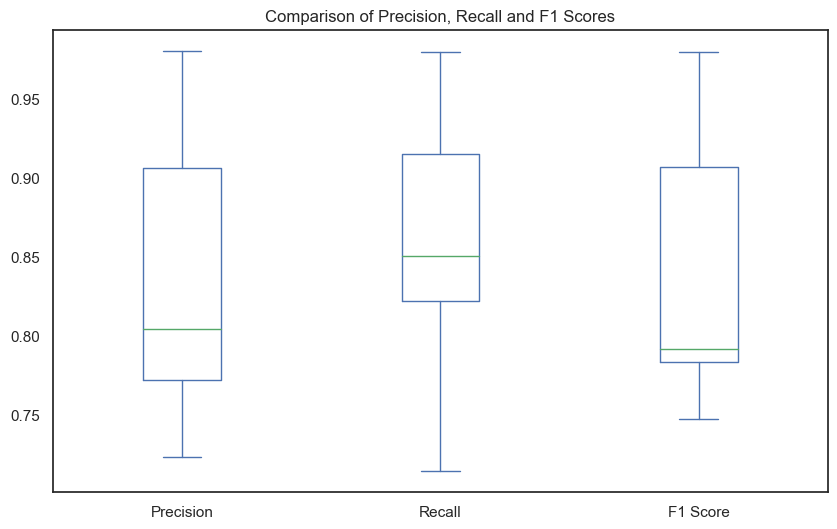

In [45]:
from sklearn.metrics import precision_score, recall_score, f1_score
import pandas as pd
import matplotlib.pyplot as plt

# Initialisation des listes pour les scores
precision_scores = []
recall_scores = []
f1_scores = []

# Calcul des scores pour chaque modèle
for name, y_pred in predictions.items():
    precision_scores.append(precision_score(y_test, y_pred, average='weighted'))  # Moyenne pondérée pour plusieurs classes
    recall_scores.append(recall_score(y_test, y_pred, average='weighted'))
    f1_scores.append(f1_score(y_test, y_pred, average='weighted'))

# Création du DataFrame pour les scores
score_df = pd.DataFrame({
    'Model': models.keys(),
    'Precision': precision_scores,
    'Recall': recall_scores,
    'F1 Score': f1_scores
})

# Affichage des scores sous forme de boxplot
score_df.set_index('Model').plot(kind='box', figsize=(10, 6))
plt.title("Comparison of Precision, Recall and F1 Scores")
plt.show()


In [67]:
from sklearn.metrics import roc_auc_score

scores = []

for name, y_pred in predictions.items():
    y_proba = models[name].predict_proba(X_test)[:, 1] if hasattr(models[name], "predict_proba") else None
    auc_score = roc_auc_score(y_test, y_proba) if y_proba is not None else None
    scores.append({
        'Model': name,
        'Precision': precision_score(y_test, y_pred),
        'Recall': recall_score(y_test, y_pred),
        'F1 Score': f1_score(y_test, y_pred),
        'AUC': auc_score
    })

scores_df = pd.DataFrame(scores)
print(scores_df)


C:\Users\Junior\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


                Model  Precision  Recall  F1 Score  AUC
0          Perceptron       0.29    0.22      0.25  NaN
1  LogisticRegression       0.25    0.03      0.05 0.72
2                 SVM       0.00    0.00      0.00 0.66
3                 KNN       0.61    0.33      0.43 0.88
4          NaiveBayes       0.27    0.52      0.35 0.65
5        DecisionTree       0.86    0.90      0.88 0.94
6        RandomForest       1.00    0.87      0.93 0.99


In [47]:
import time
import pandas as pd

# Initialisation des listes pour les temps d'entraînement et de prédiction
training_times = []
prediction_times = []

for name, model in models.items():
    # Mesure du temps d'entraînement
    start_time = time.time()
    model.fit(X_train, y_train)
    training_times.append(time.time() - start_time)  # Temps d'entraînement

    # Mesure du temps de prédiction
    start_time = time.time()
    model.predict(X_test)
    prediction_times.append(time.time() - start_time)  # Temps de prédiction

# Création du DataFrame avec les temps
time_df = pd.DataFrame({
    'Model': models.keys(),
    'Training Time (s)': training_times,
    'Prediction Time (s)': prediction_times
})

# Affichage des résultats
print(time_df)


                Model  Training Time (s)  Prediction Time (s)
0          Perceptron               0.02                 0.00
1  LogisticRegression               0.19                 0.00
2                 SVM               2.20                 0.23
3                 KNN               0.00                 0.25
4          NaiveBayes               0.00                 0.00
5        DecisionTree               0.03                 0.00
6        RandomForest               0.76                 0.04


### Conclusions sur les modèles :

Les arbres de décision (Decision Tree et Random Forest) sont clairement les modèles les plus adaptés pour ce problème, en particulier Random Forest, qui offre une précision exceptionnelle et un excellent score F1 pour les employés susceptibles de quitter l'entreprise.

Après avoir choisi le ***modèle Random Forest*** comme le plus performant, l'étape suivante consiste à optimiser ses hyperparamètres pour améliorer encore ses performances. L'optimisation des hyperparamètres est cruciale pour s'assurer que le modèle est bien ajusté aux données et qu'il ne souffre pas de ***surapprentissage (overfitting)*** ou de sous-***apprentissage (underfitting)***.


#### Optimisation des Hyperparamètres : Random Forest

In [69]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV

# Définition de la grille d'hyperparamètres
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'max_features': ['auto', 'sqrt']
}

# Initialisation du modèle Random Forest
rf_model = RandomForestClassifier(random_state=42)

# Configuration de Grid Search avec validation croisée
grid_search = GridSearchCV(
    estimator=rf_model,
    param_grid=param_grid,
    cv=5,
    scoring='f1',
    verbose=2,
    n_jobs=-1
)

# Exécution de Grid Search
grid_search.fit(X_train, y_train)

# Meilleurs paramètres
best_params = grid_search.best_params_
print("Meilleurs paramètres : ", best_params)

# Meilleur modèle optimisé
optimized_rf_model = grid_search.best_estimator_

# Afficher le score F1 avec les meilleurs hyperparamètres
print("Score F1 avec les meilleurs hyperparamètres :", grid_search.best_score_)


Fitting 5 folds for each of 216 candidates, totalling 1080 fits
Meilleurs paramètres :  {'max_depth': 20, 'max_features': 'auto', 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 300}
Score F1 avec les meilleurs hyperparamètres : 0.8658874232383125


In [70]:
# Obtenir le modèle avec les meilleurs hyperparamètres
best_rf = grid_search.best_estimator_

# Faire des prédictions sur les données de test
y_pred = best_rf.predict(X_test)

# Calculer le F1 Score sur les données de test
f1 = f1_score(y_test, y_pred)
print("F1 Score sur les données de test :", f1)

# Afficher la matrice de confusion
conf_matrix = confusion_matrix(y_test, y_pred)
print("Matrice de confusion :\n", conf_matrix)

# Afficher le rapport de classification
class_report = classification_report(y_test, y_pred)
print("Rapport de classification :\n", class_report)

F1 Score sur les données de test : 0.9297297297297298
Matrice de confusion :
 [[1125    0]
 [  26  172]]
Rapport de classification :
               precision    recall  f1-score   support

           0       0.98      1.00      0.99      1125
           1       1.00      0.87      0.93       198

    accuracy                           0.98      1323
   macro avg       0.99      0.93      0.96      1323
weighted avg       0.98      0.98      0.98      1323



On Obtient un f1-Score très bon dans les deux cas.

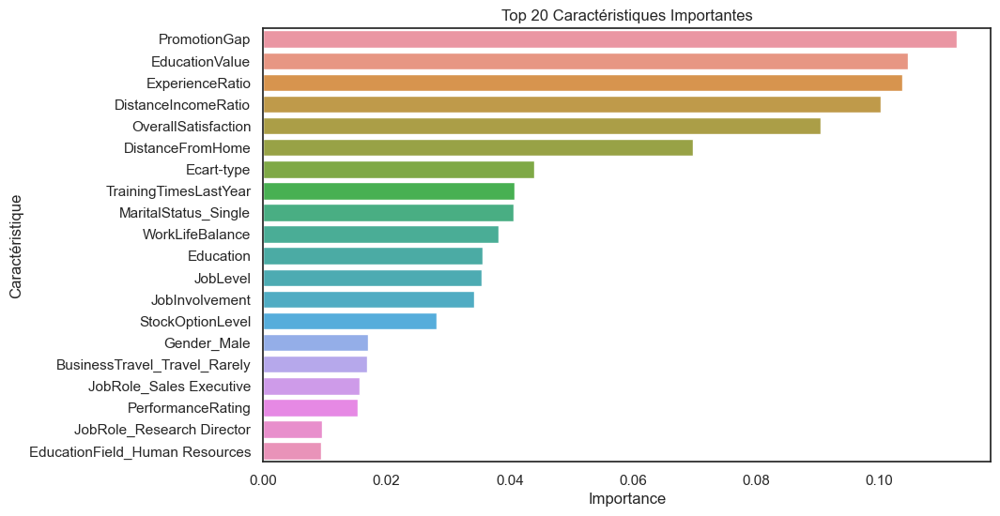

In [73]:
# Tracer les caractéristiques importantes
plt.figure(figsize=(10, 6))
sns.barplot(x='Importance', y='Feature', data=feature_importance_df.head(20))  # Top 20 caractéristiques
plt.title('Top 20 Caractéristiques Importantes')
plt.xlabel('Importance')
plt.ylabel('Caractéristique')
plt.show()


### **Interprétation des Caractéristiques Importantes**

#### **1. Facteurs Clés de l'Attrition**
Les caractéristiques les plus importantes sont les suivantes :

| **Feature**                |**Interprétation**                                                                |
|----------------------------|-----------------------------------------------------------------------------------|
| **PromotionGap**           | L'écart entre l'ancienneté et la dernière promotion est un facteur clé. Les employés qui n'ont pas été promus récemment sont plus susceptibles de partir. |
| **EducationValue**         | Le niveau d'éducation est important. Les employés avec un faible niveau d'éducation pourraient être plus mobiles. |
| **ExperienceRatio**        | Le ratio entre les années d'expérience totales et l'ancienneté dans l'entreprise est un indicateur clair. Les employés avec plus d'expérience totale que d'ancienneté sont plus susceptibles de partir. |
| **DistanceIncomeRatio**    | Le ratio entre la distance du domicile à l'entreprise et le salaire mensuel est important. Les employés qui vivent loin et sont sous-payés sont plus susceptibles de quitter. |
| **OverallSatisfaction**    | La satisfaction globale (combinaison de la satisfaction au travail et de l'environnement de travail) est un facteur clé. Les employés insatisfaits sont plus susceptibles de partir. |
| **DistanceFromHome**       | La distance entre le domicile et l'entreprise est un facteur important. Les employés qui vivent loin sont plus susceptibles de partir. |
| **Ecart-type**             | L'irrégularité des horaires de travail (écart-type des heures travaillées) est un facteur important. Les horaires irréguliers peuvent détériorer la satisfaction au travail. |
| **TrainingTimesLastYear**  | Le nombre de jours de formation suivis l'année dernière est important. Les employés qui ne bénéficient pas de formation sont plus susceptibles de partir. |
| **MaritalStatus_Single**   | Le statut marital est un facteur important. Les employés célibataires sont plus susceptibles de partir. |
| **WorkLifeBalance**        | L'équilibre entre vie professionnelle et vie privée est important. Les employés qui ne trouvent pas cet équilibre sont plus susceptibles de partir. |

---

#### **2. Facteurs Secondaires**
Les autres caractéristiques importantes sont les suivantes :

| **Feature**                | **Interprétation**                                                                 |
|----------------------------|-----------------------------------------------------------------------------------|
| **Education**              | Le niveau d'éducation est un facteur secondaire. Les employés avec un faible niveau d'éducation pourraient être plus mobiles. |
| **JobLevel**               | Le niveau hiérarchique est un facteur secondaire. Les employés au bas de l'échelle hiérarchique sont plus susceptibles de partir. |
| **JobInvolvement**         | L'implication dans le travail est un facteur secondaire. Les employés moins impliqués sont plus susceptibles de partir. |
| **StockOptionLevel**       | Le niveau d'options sur actions est un facteur secondaire. Les employés avec peu ou pas d'options sur actions sont plus susceptibles de partir. |
| **Gender_Male**            | Le genre est un facteur secondaire. Les hommes pourraient être plus susceptibles de partir. |
| **BusinessTravel_Travel_Rarely** | Les employés qui voyagent rarement sont un peu plus susceptibles de partir. |
| **JobRole_Sales Executive** | Le rôle de Sales Executive est un facteur secondaire. Les employés dans ce rôle pourraient être plus susceptibles de partir. |
| **PerformanceRating**      | La note de performance est un facteur secondaire. Les employés avec une faible note de performance sont plus susceptibles de partir. |



### **Conclusion**
L'analyse des caractéristiques importantes permet d'identifier les facteurs clés de l'attrition et de formuler des recommandations concrètes pour réduire le taux de rotation des employés. Les résultats montrent que la promotion, le niveau d'éducation, l'expérience, la rémunération, la satisfaction au travail et l'équilibre vie professionnelle/vie privée sont des facteurs cruciaux.

---


## Respect des Normes Éthiques dans l'Utilisation de l'IA

- **Respect de l'autonomie humaine**
Les prédictions ne limitent pas l'autonomie des employés.
- **Robustesse technique et sécurité**
Le modèle a été testé pour assurer sa robustesse et sa sécurité.
- **Confidentialité et gouvernance des données**
Les données ont été traitées avec respect et conformément aux règles de gouvernance.
- **Transparence**
Les décisions prises dans le projet ont été documentées de manière transparente.
- **Diversité, non-discrimination et équité**
Le modèle ne discrimine pas sur la base de caractéristiques protégées.
- **Bien-être environnemental et sociétal**
Le projet a un impact positif en réduisant le taux de rotation des employés.
- **Responsabilité**
La responsabilité des décisions prises dans le projet est assumée.

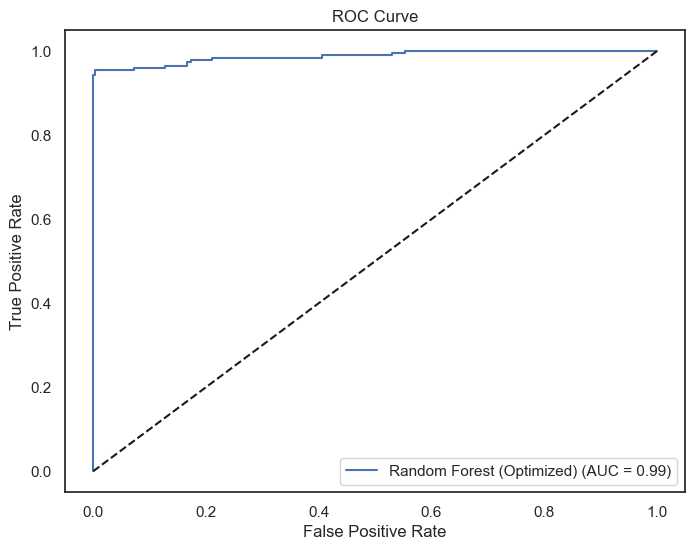

In [75]:
fpr, tpr, _ = roc_curve(y_test, y_proba_rf)
auc = roc_auc_score(y_test, y_proba_rf)

# Tracer la courbe
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, label=f"Random Forest (Optimized) (AUC = {auc:.2f})")
plt.plot([0, 1], [0, 1], 'k--')  # Ligne de référence
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("ROC Curve")
plt.legend()
plt.show()

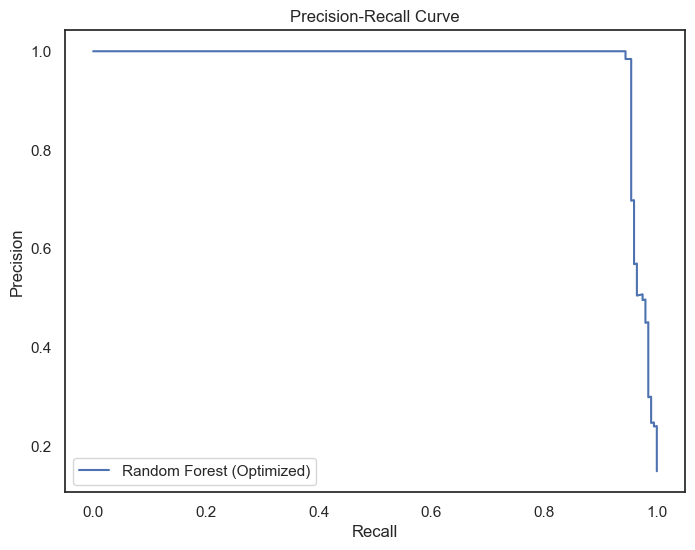

In [74]:
# Probabilités prédites pour la classe positive avec le modèle amélioré
y_proba_rf = optimized_rf_model.predict_proba(X_test)[:, 1]

# Calcul des courbes Précision-Rappel
precision, recall, _ = precision_recall_curve(y_test, y_proba_rf)

# Tracer la courbe
plt.figure(figsize=(8, 6))
plt.plot(recall, precision, label="Random Forest (Optimized)")
plt.xlabel("Recall")
plt.ylabel("Precision")
plt.title("Precision-Recall Curve")
plt.legend()
plt.show()